In [1]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

Load and preprocess stereo image pairs from a folder

In [2]:
def load_stereo_pairs(folder_path, left_suffix='l', right_suffix='r'):
    files = sorted(os.listdir(folder_path))
    left_images = []
    right_images = []
    # Separate left and right images
    for file in files:
        if left_suffix in file:
            left_images.append(file)
        elif right_suffix in file:
            right_images.append(file)
    left_images = sorted(left_images)
    right_images = sorted(right_images)
    # Pair the images together
    pairs = []
    for left_img_name, right_img_name in zip(left_images, right_images):
        left_path = os.path.join(folder_path, left_img_name)
        right_path = os.path.join(folder_path, right_img_name)
        left_img = cv2.imread(left_path, cv2.IMREAD_GRAYSCALE)
        right_img = cv2.imread(right_path, cv2.IMREAD_GRAYSCALE)
        if left_img is None or right_img is None:
            print(f"Warning: Could not load {left_img_name} or {right_img_name}")
            continue
        pairs.append((left_img, right_img))
    return pairs


def plot_stereo_pairs(pairs, gap_width=20):
    for idx, (left_img, right_img) in enumerate(pairs):
        # Create a white gap bet the left & right images
        gap = np.ones((left_img.shape[0], gap_width), dtype=np.uint8) * 255
        # Concatenate the left image, gap & right image horizontally
        combined = np.hstack((left_img, gap, right_img))
        # Create a figure with enough size
        plt.figure(figsize=(10, 5))
        plt.title(f"Stereo Pair {idx + 1} (Left | Right)")
        plt.imshow(combined, cmap='gray')
        plt.axis('off')
        # Adjust subplot to prevent clipping
        plt.subplots_adjust(left=0.05, right=0.95, top=0.95, bottom=0.05)
        # Show the image
        plt.show()

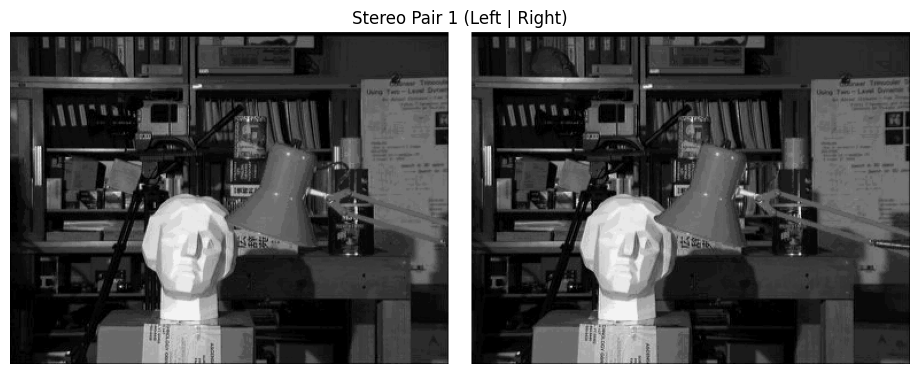

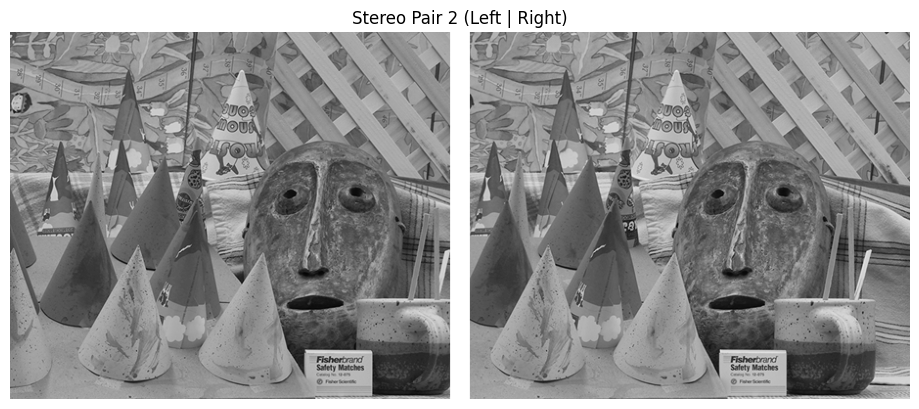

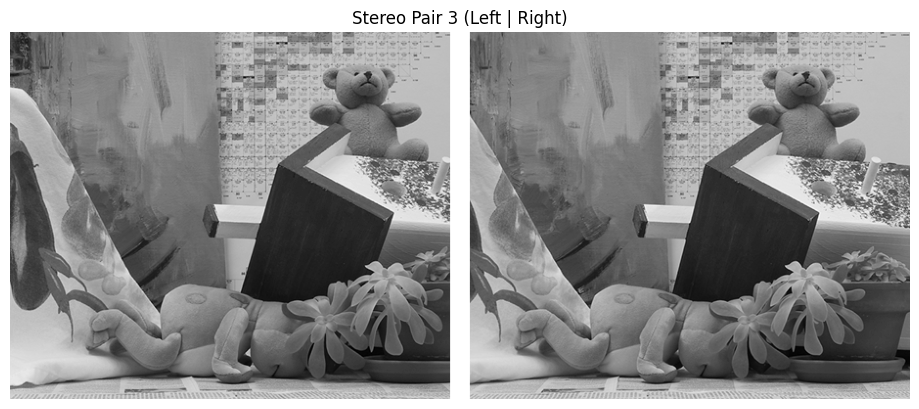

In [3]:
# Preprocessing of image pairs to be visualised 
pairs = load_stereo_pairs(folder_path=r'D:\College-MRE\Computer Vision\Lab Assig\assig3\stereo_materials')
plot_stereo_pairs(pairs)

Compute disparity by Block Matching; using SAD and SSD

In [ ]:
def compute_disparity_blockmatch(lI, rI, window_size, method, max_disp):
    # Get image dimensions
    h, w = lI.shape
    # Initialize disparity map
    disparity = np.zeros((h, w), dtype=np.float32)
    # Half window size for symmetric patch extraction
    half_w = window_size // 2

    # Loop over each pixel (excluding borders)
    for y in range(half_w, h - half_w):
        for x in range(half_w, w - half_w):
            # Best disparity for this pixel
            best_offset = 0
            # Initialize cost to a large value
            min_cost = float('inf')
            # Extract the patch from the left image centered at (x, y)
            left_patch = lI[y-half_w:y + half_w+1, x-half_w:x + half_w+1]

            # Search over possible disparities
            for d in range(min(max_disp, x - half_w)):
                # Corresponding x in the right image (same row)
                xr = x - d
                # Prevent going out of bounds on the right image
                if xr - half_w < 0:
                    continue
                # Extract the corresponding patch from the right image
                right_patch = rI[y-half_w:y + half_w+1, xr-half_w:xr + half_w+1]

                # Compute cost between patches using SAD or SSD methods
                if method == 'SAD':
                    cost = np.sum(np.abs(left_patch - right_patch))
                elif method == 'SSD':
                    cost = np.sum((left_patch - right_patch)** 2)
                else:
                    raise ValueError("Unsupported method: use 'SAD' or 'SSD'.")
                
                # Keep track of the best disparity (lowest cost)
                if cost < min_cost:
                    min_cost = cost
                    best_offset = d
            disparity[y, x] = best_offset

    # Normalize disparity map for visualization
    disparity = cv2.normalize(disparity, None, 0, 255, cv2.NORM_MINMAX)
    return disparity.astype(np.uint8)


def plot_disparity_map(disparity, title):
    # Plot the disparity map using a color heatmap
    plt.figure(figsize=(10, 5))
    plt.title(title)
    plt.imshow(disparity, cmap='jet')
    plt.colorbar(label='Disparity')
    plt.axis('off')
    plt.show()

Experimenting by maximum disparity of 50


Processing stereo pair 1...
Computing disparity (w=1, method=SAD)...


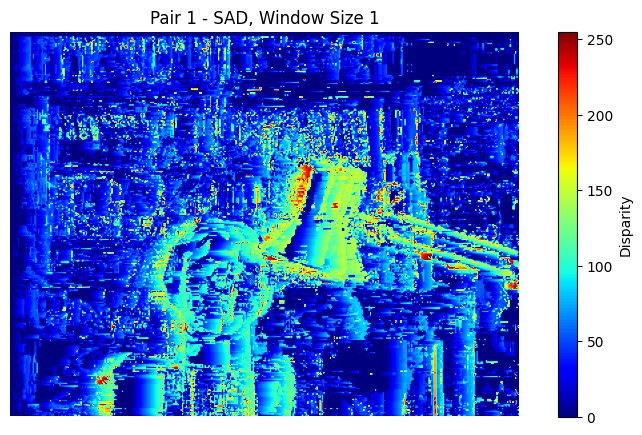

Computing disparity (w=1, method=SSD)...


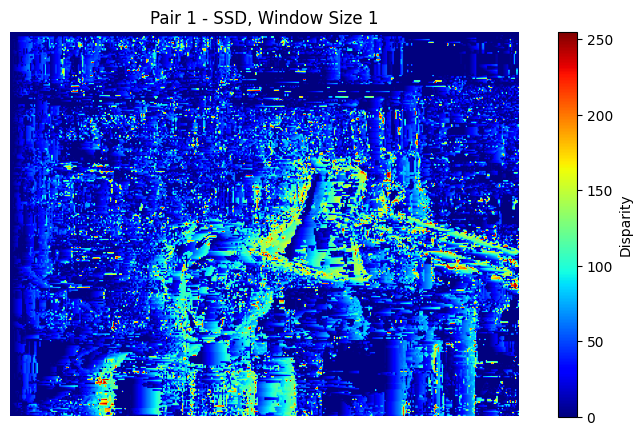

Computing disparity (w=5, method=SAD)...


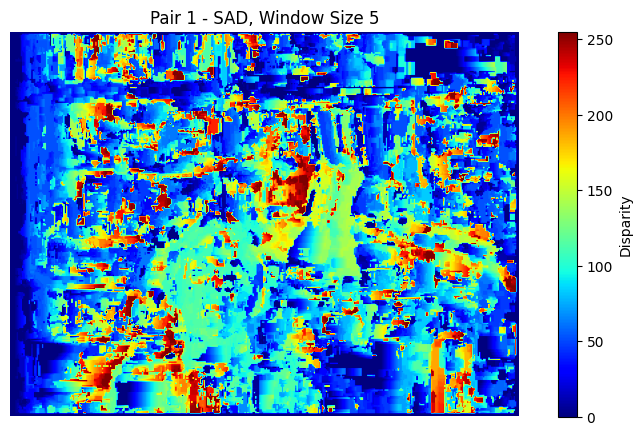

Computing disparity (w=5, method=SSD)...


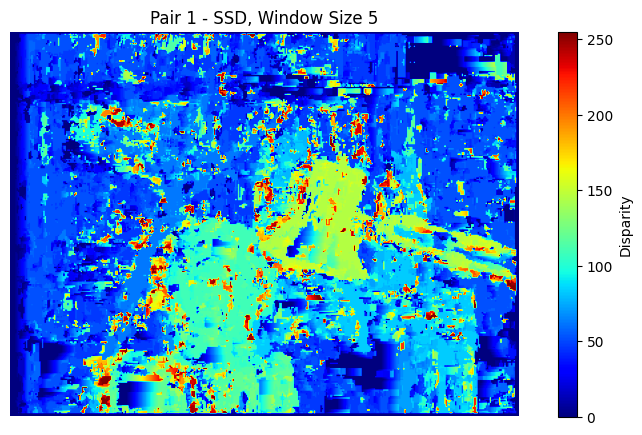

Computing disparity (w=9, method=SAD)...


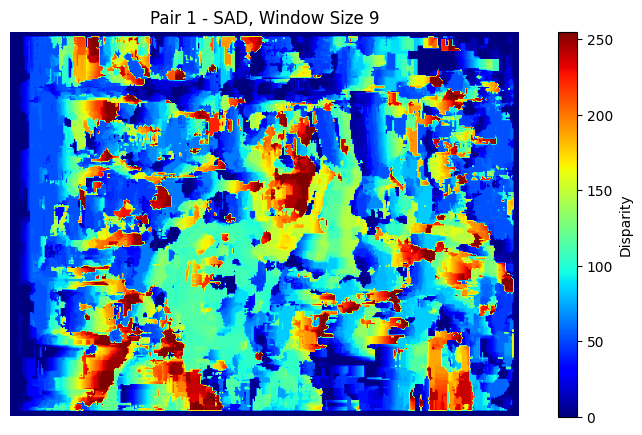

Computing disparity (w=9, method=SSD)...


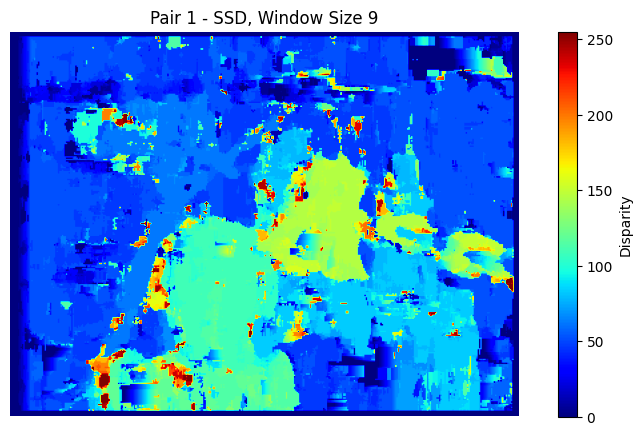


Processing stereo pair 2...
Computing disparity (w=1, method=SAD)...


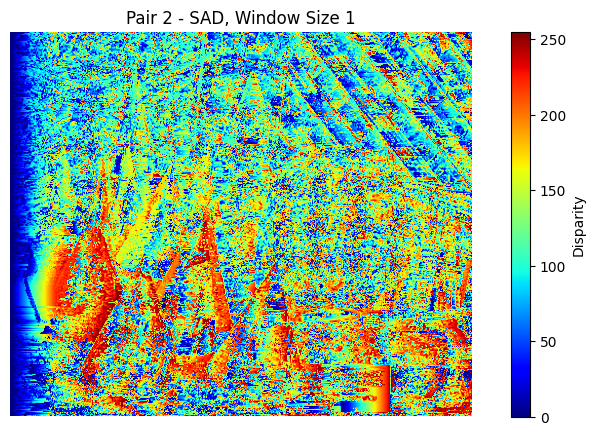

Computing disparity (w=1, method=SSD)...


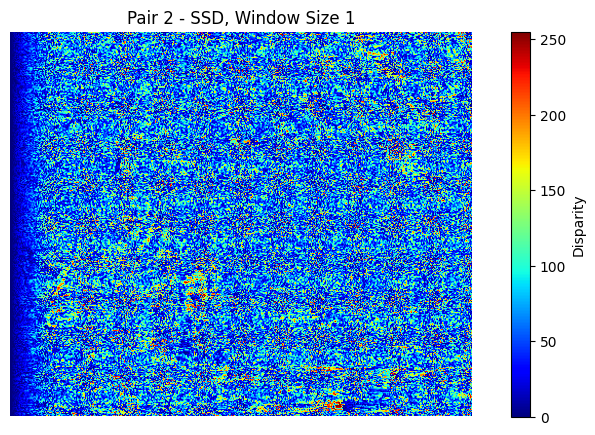

Computing disparity (w=5, method=SAD)...


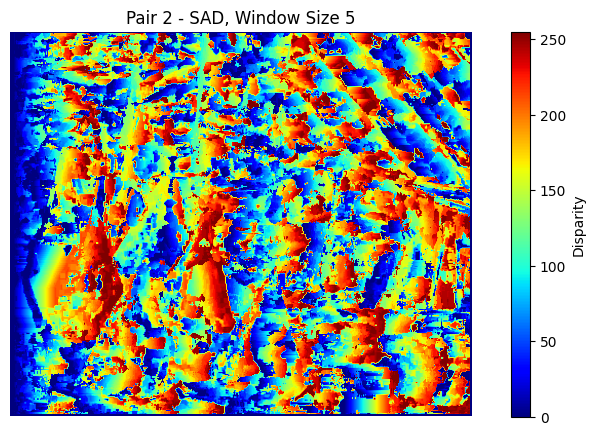

Computing disparity (w=5, method=SSD)...


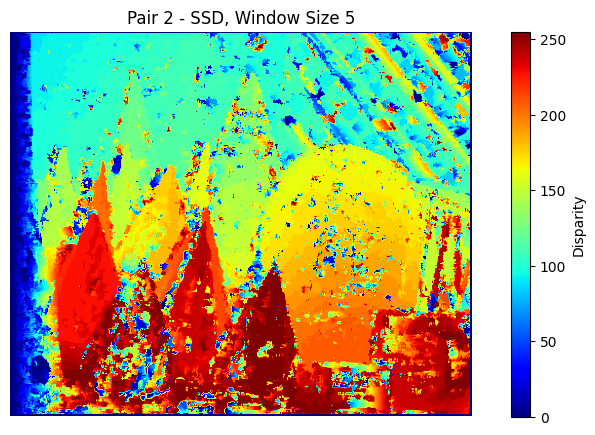

Computing disparity (w=9, method=SAD)...


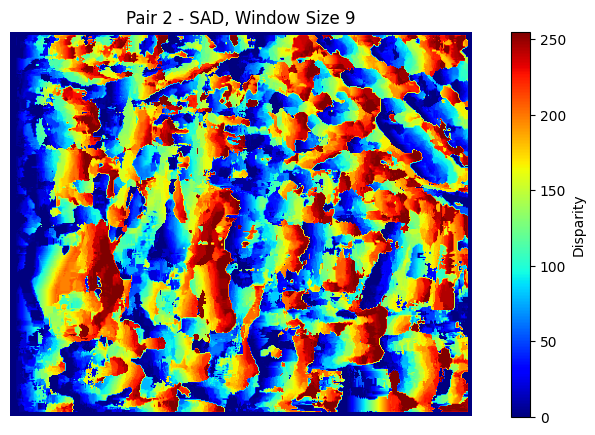

Computing disparity (w=9, method=SSD)...


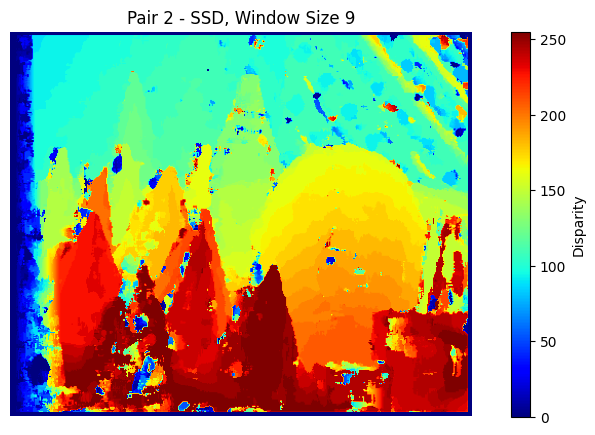


Processing stereo pair 3...
Computing disparity (w=1, method=SAD)...


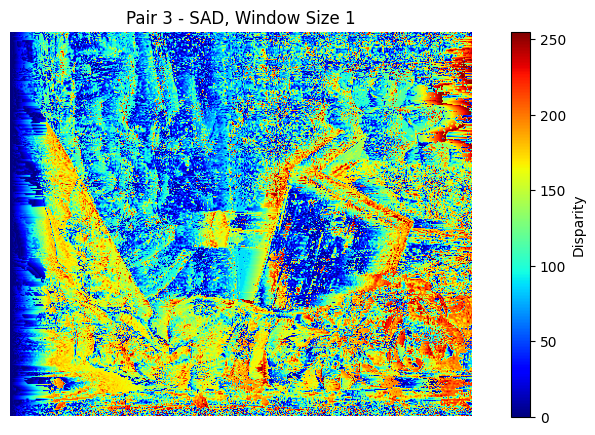

Computing disparity (w=1, method=SSD)...


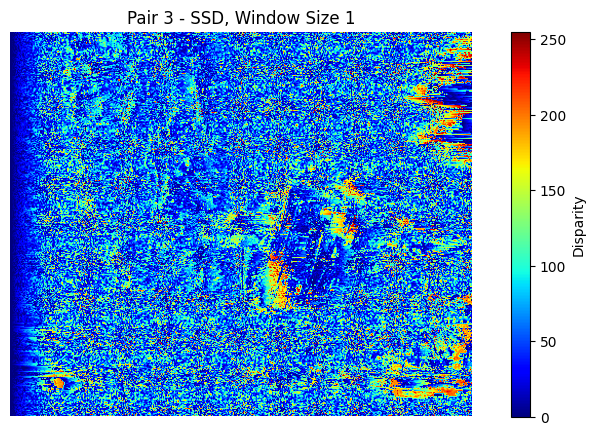

Computing disparity (w=5, method=SAD)...


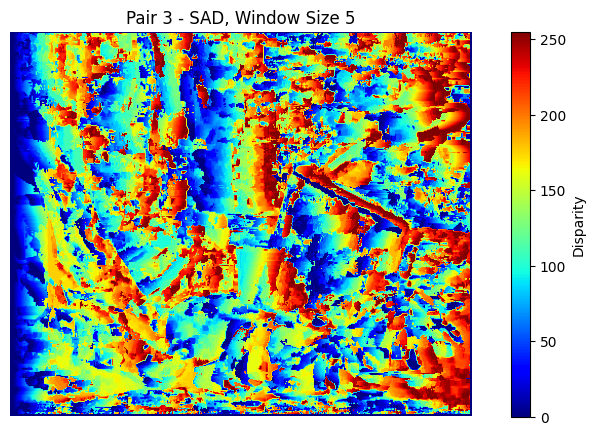

Computing disparity (w=5, method=SSD)...


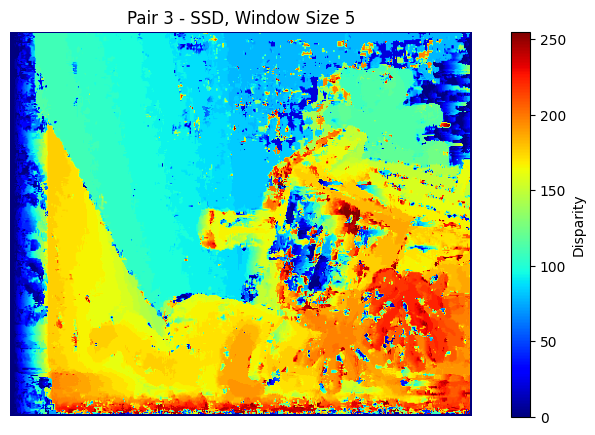

Computing disparity (w=9, method=SAD)...


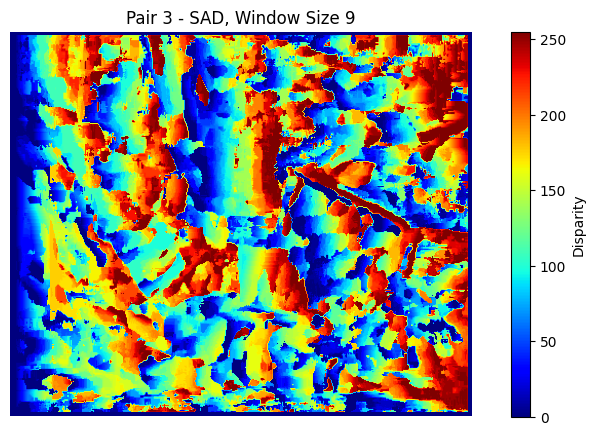

Computing disparity (w=9, method=SSD)...


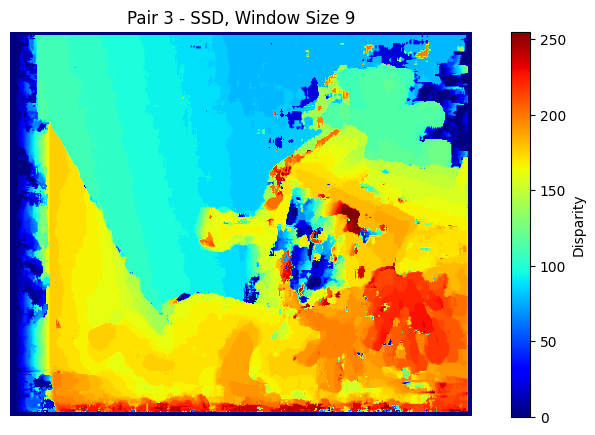

In [ ]:
# Disparity computation for window sizes = 1, 5, 9 using both SAD & SSD
window_sizes = [1, 5, 9]
methods = ['SAD', 'SSD']

# Loop through each preprocessed stereo pair
for idx, (lI, rI) in enumerate(pairs):
    print(f"\nProcessing stereo pair {idx+1}...")
    for w in window_sizes:
        for method in methods:
            print(f"Computing disparity (w={w}, method={method})...")
            disp = compute_disparity_blockmatch(lI, rI, window_size=w, method=method, max_disp = 50)
            plot_disparity_map(disp, title=f"Pair {idx+1} - {method}, Window Size {w}")

Experimenting by a maximum disparity of 40


Processing stereo pair 1...
Computing disparity (w=1, method=SAD)...


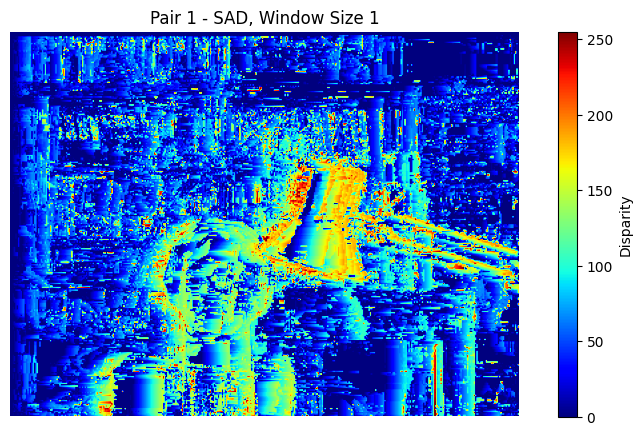

Computing disparity (w=1, method=SSD)...


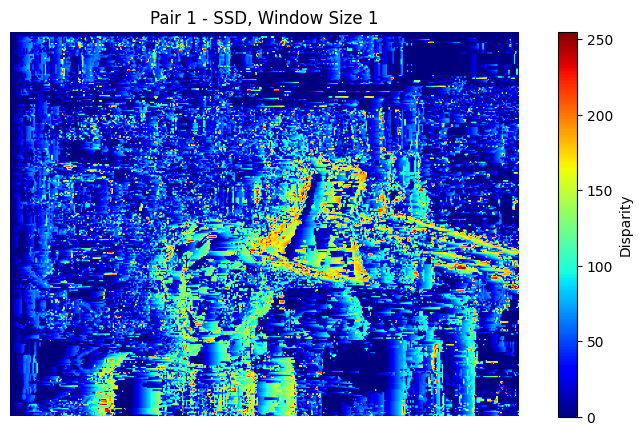

Computing disparity (w=5, method=SAD)...


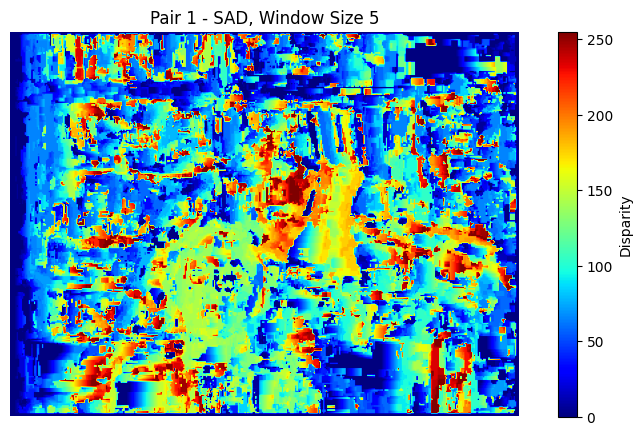

Computing disparity (w=5, method=SSD)...


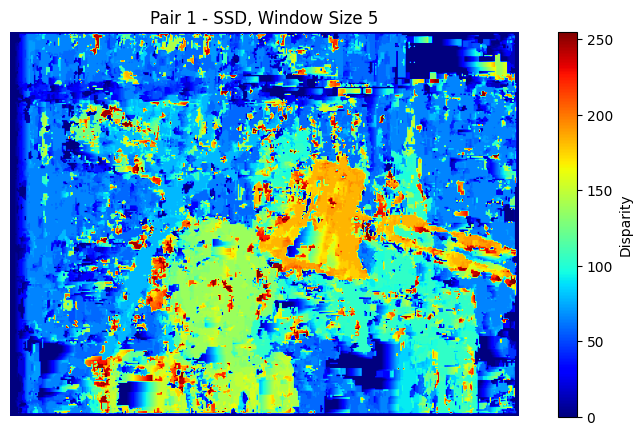

Computing disparity (w=9, method=SAD)...


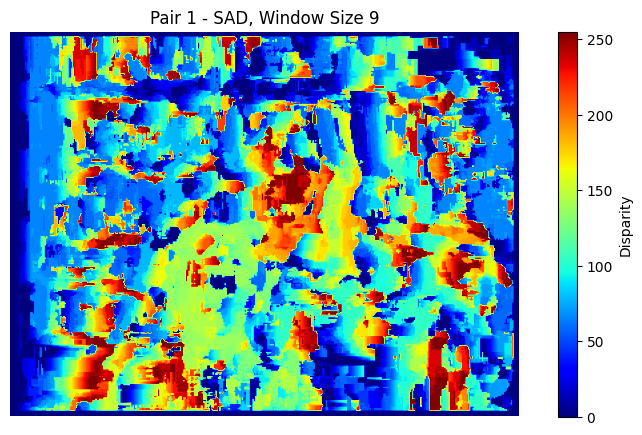

Computing disparity (w=9, method=SSD)...


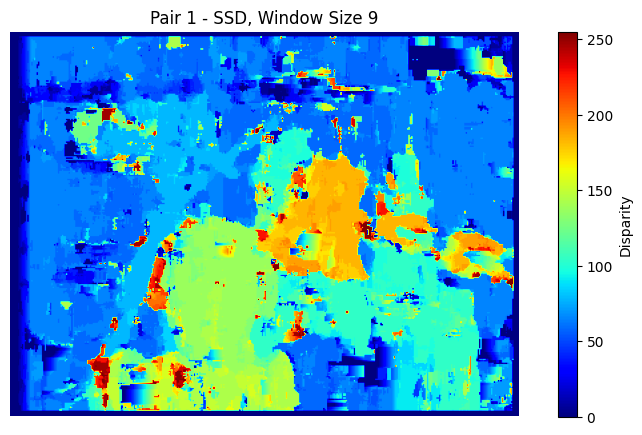


Processing stereo pair 2...
Computing disparity (w=1, method=SAD)...


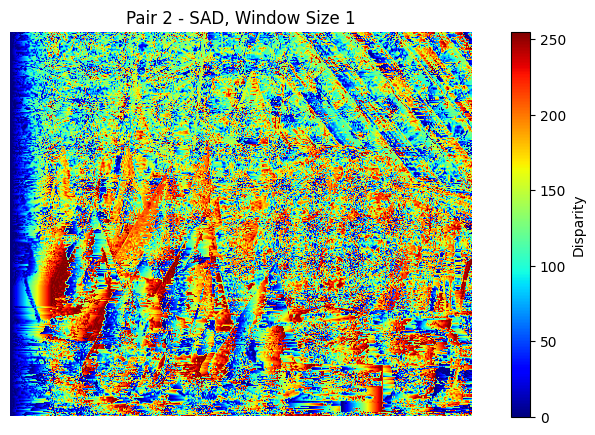

Computing disparity (w=1, method=SSD)...


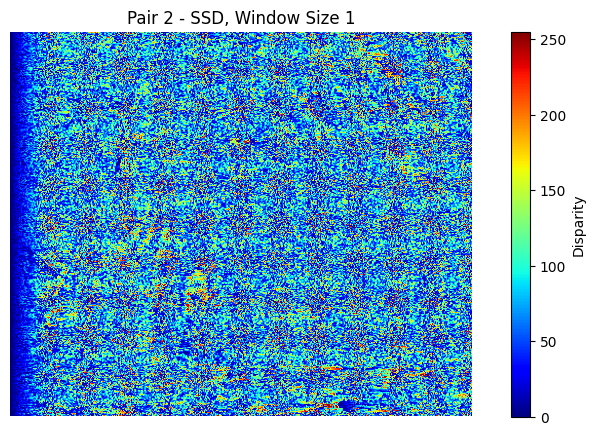

Computing disparity (w=5, method=SAD)...


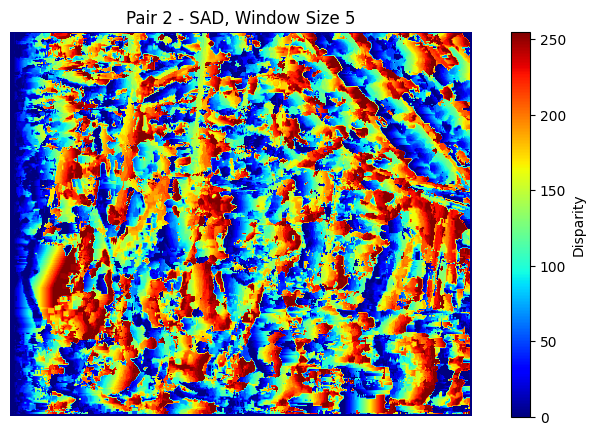

Computing disparity (w=5, method=SSD)...


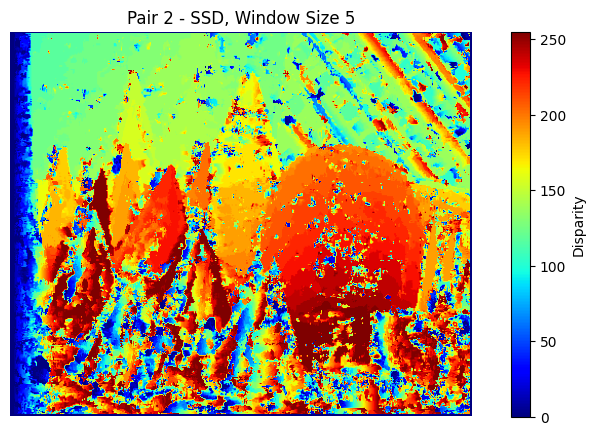

Computing disparity (w=9, method=SAD)...


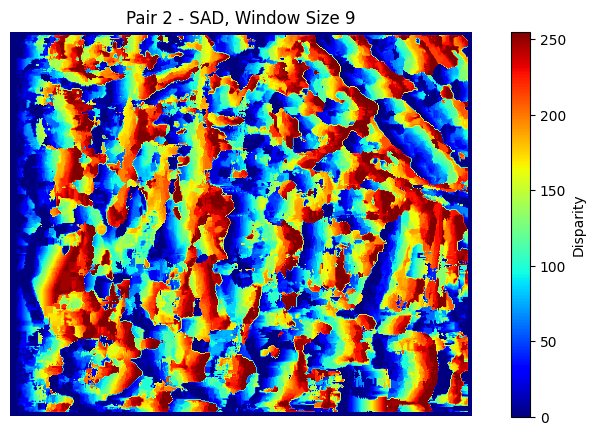

Computing disparity (w=9, method=SSD)...


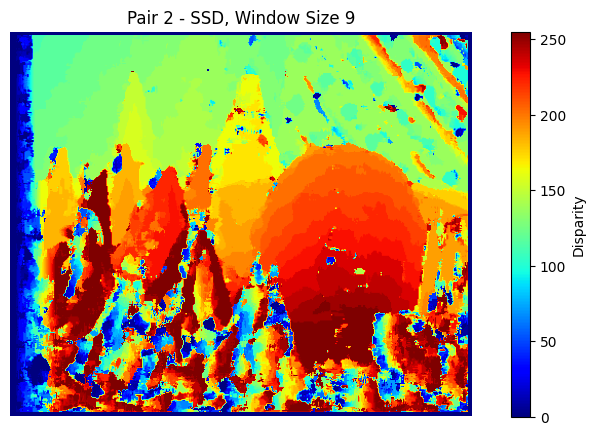


Processing stereo pair 3...
Computing disparity (w=1, method=SAD)...


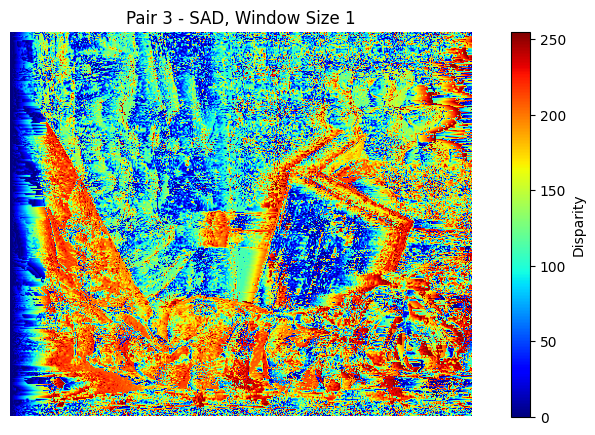

Computing disparity (w=1, method=SSD)...


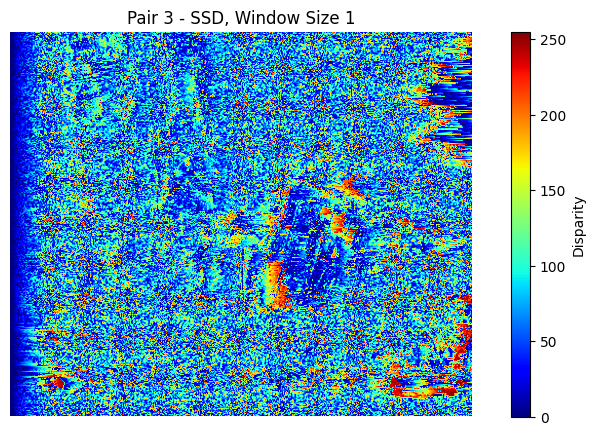

Computing disparity (w=5, method=SAD)...


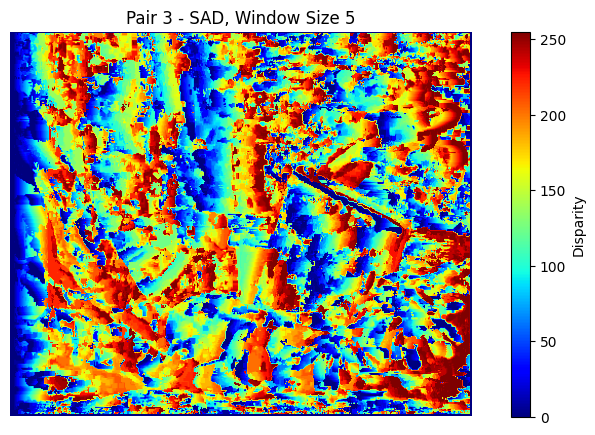

Computing disparity (w=5, method=SSD)...


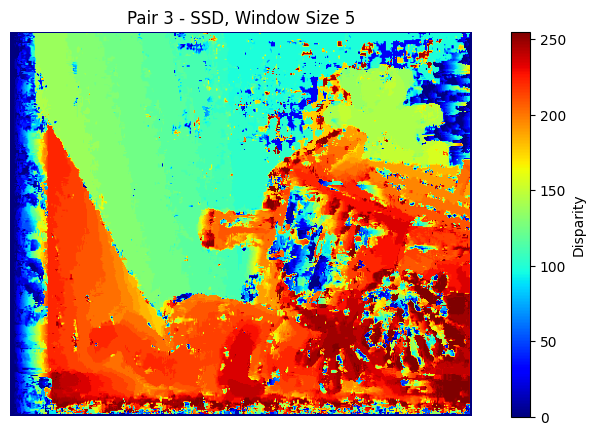

Computing disparity (w=9, method=SAD)...


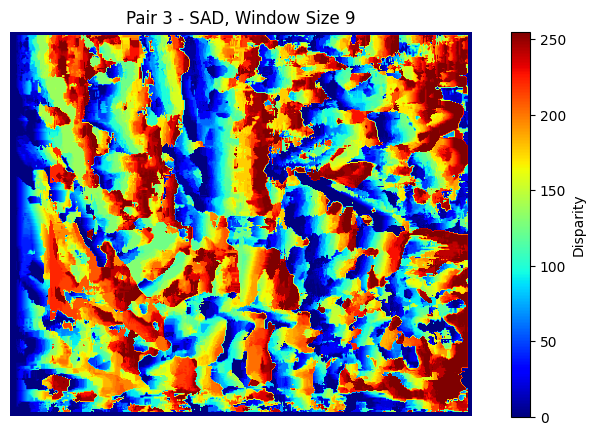

Computing disparity (w=9, method=SSD)...


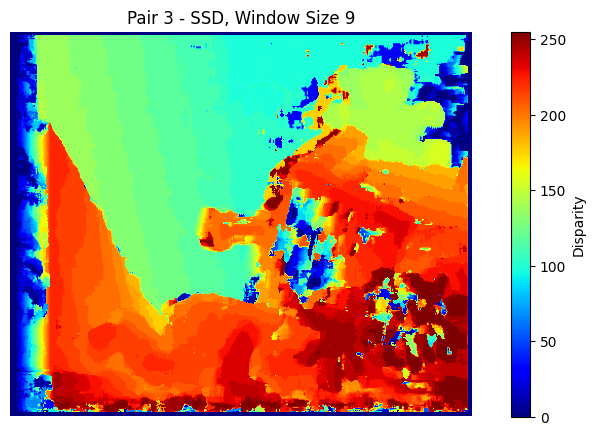

In [7]:
# Disparity computation for window sizes = 1, 5, 9 using both SAD & SSD
window_sizes = [1, 5, 9]
methods = ['SAD', 'SSD']

# Loop through each preprocessed stereo pair
for idx, (lI, rI) in enumerate(pairs):
    print(f"\nProcessing stereo pair {idx+1}...")
    for w in window_sizes:
        for method in methods:
            print(f"Computing disparity (w={w}, method={method})...")
            disp = compute_disparity_blockmatch(lI, rI, window_size=w, method=method, max_disp = 40)
            plot_disparity_map(disp, title=f"Pair {idx+1} - {method}, Window Size {w}")

Experimenting by maximum disparity of 80


Processing stereo pair 1...
Computing disparity (w=1, method=SAD)...


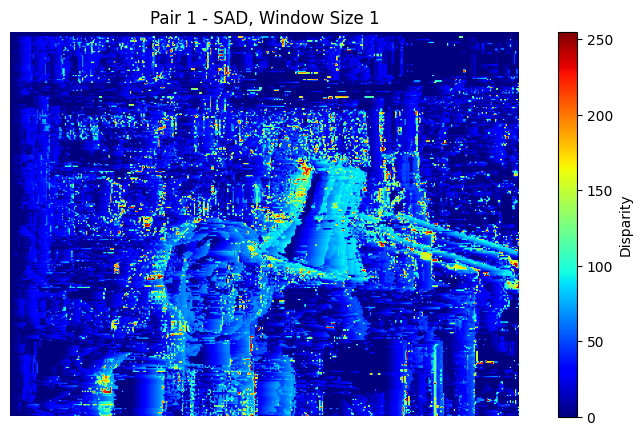

Computing disparity (w=1, method=SSD)...


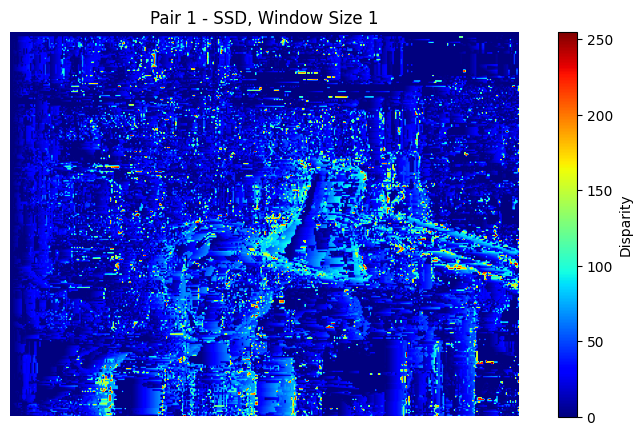

Computing disparity (w=5, method=SAD)...


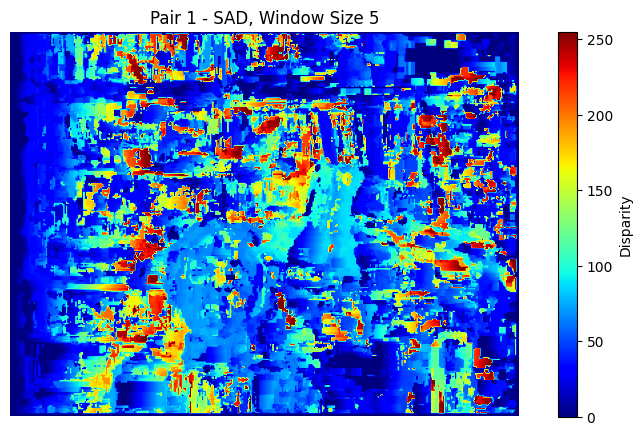

Computing disparity (w=5, method=SSD)...


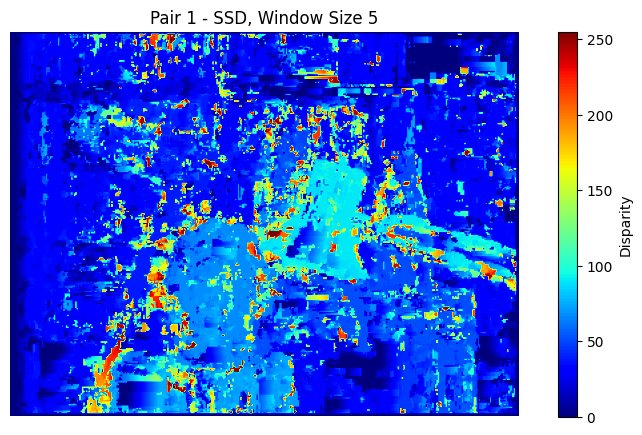

Computing disparity (w=9, method=SAD)...


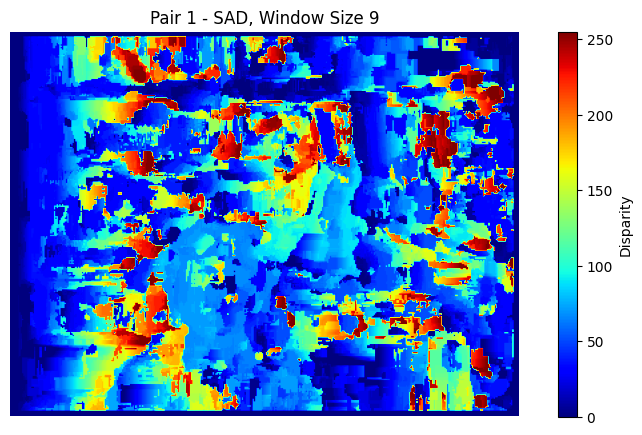

Computing disparity (w=9, method=SSD)...


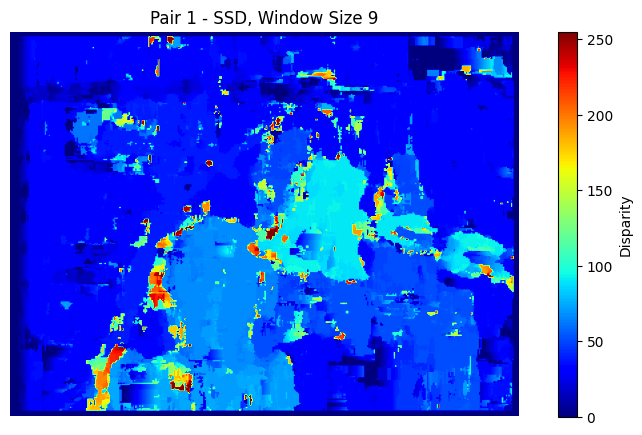


Processing stereo pair 2...
Computing disparity (w=1, method=SAD)...


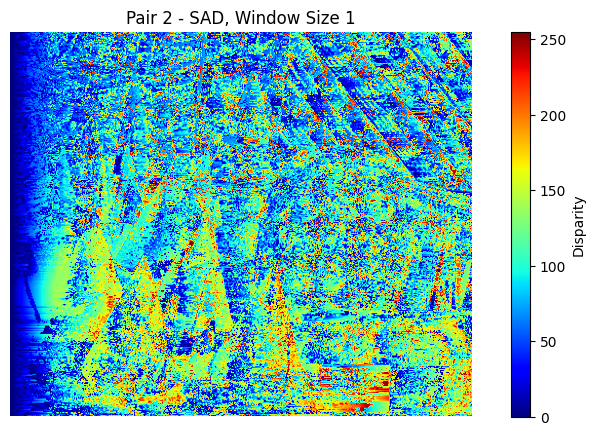

Computing disparity (w=1, method=SSD)...


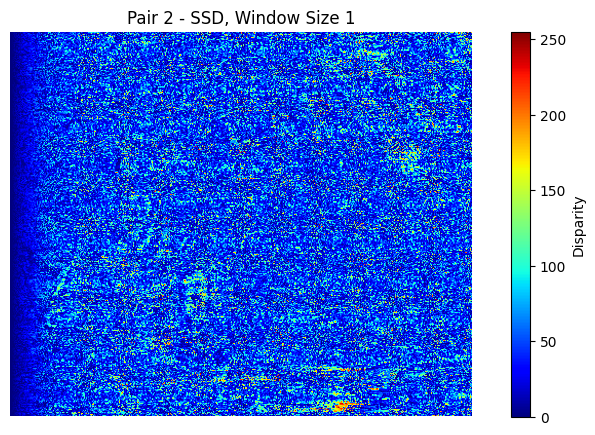

Computing disparity (w=5, method=SAD)...


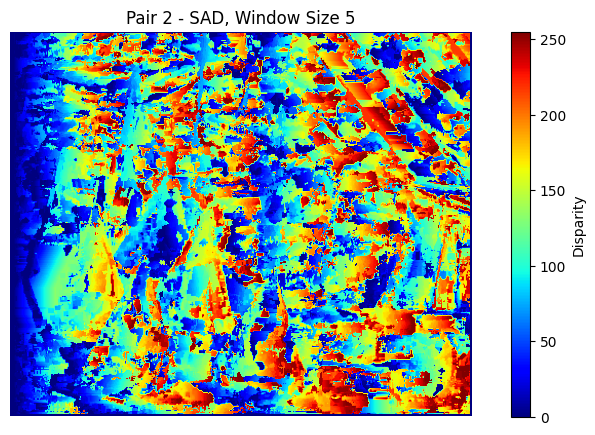

Computing disparity (w=5, method=SSD)...


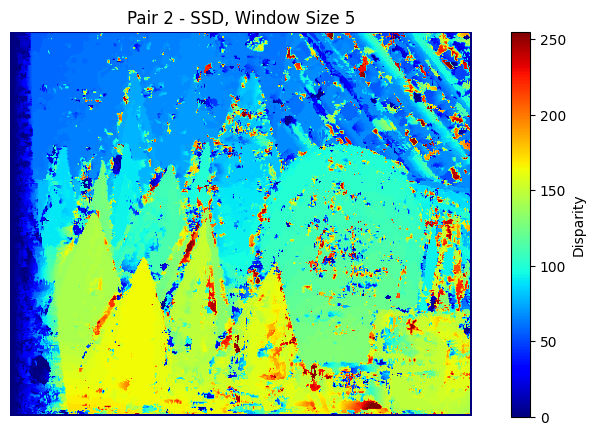

Computing disparity (w=9, method=SAD)...


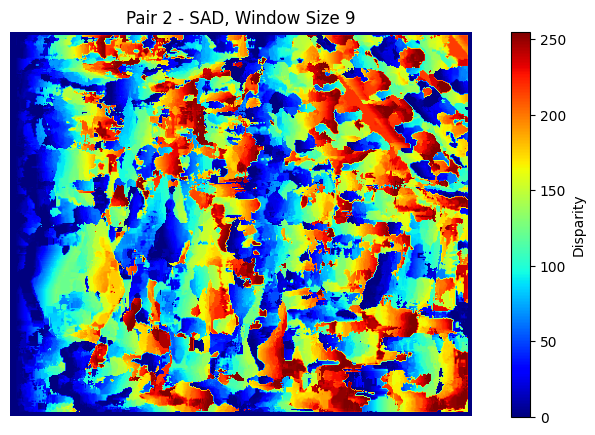

Computing disparity (w=9, method=SSD)...


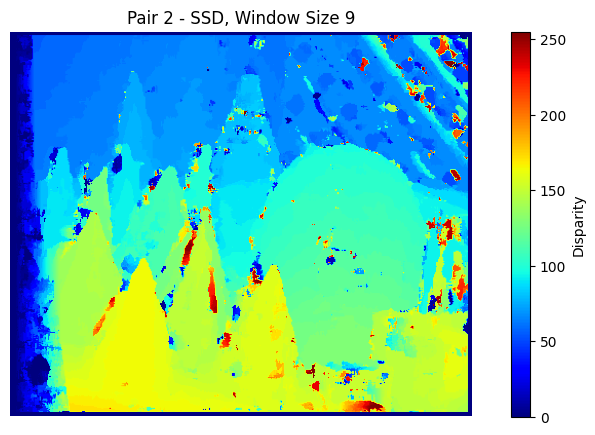


Processing stereo pair 3...
Computing disparity (w=1, method=SAD)...


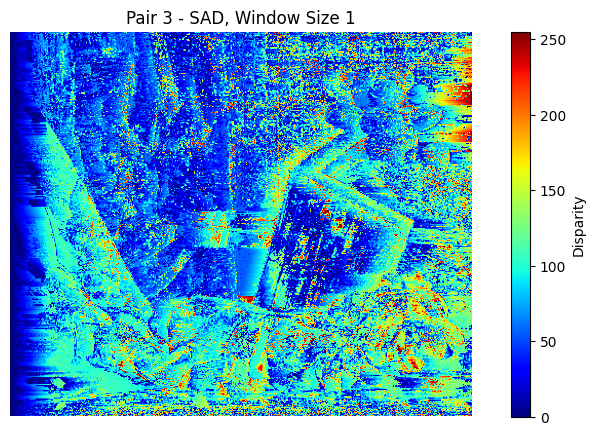

Computing disparity (w=1, method=SSD)...


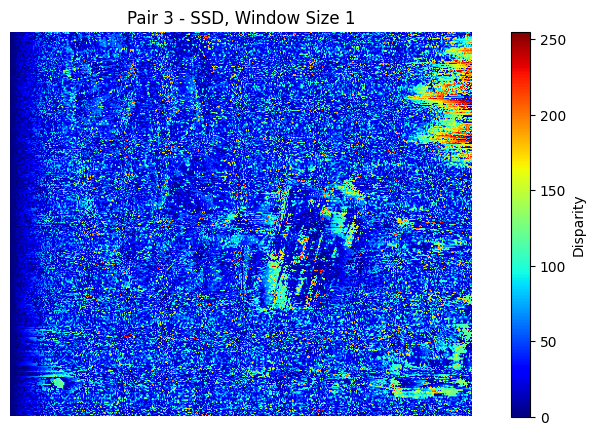

Computing disparity (w=5, method=SAD)...


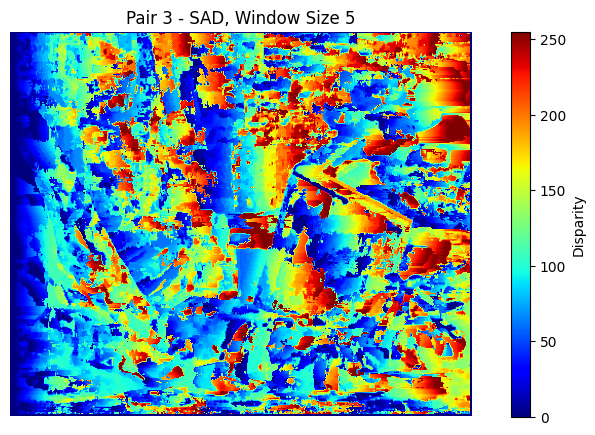

Computing disparity (w=5, method=SSD)...


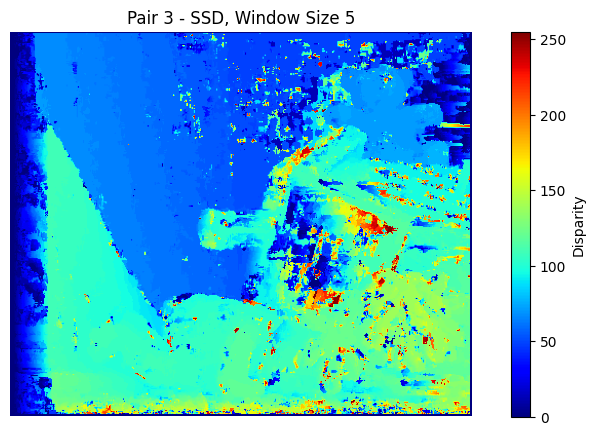

Computing disparity (w=9, method=SAD)...


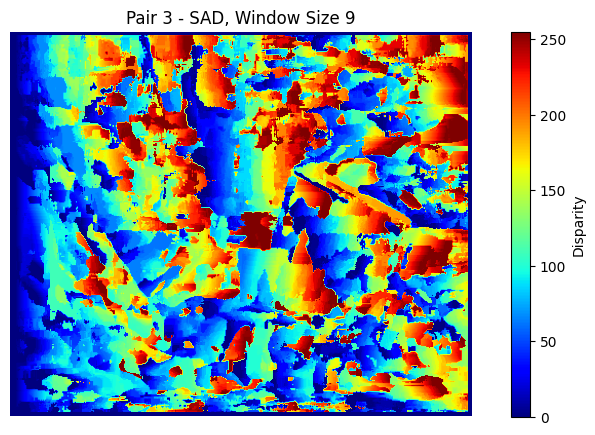

Computing disparity (w=9, method=SSD)...


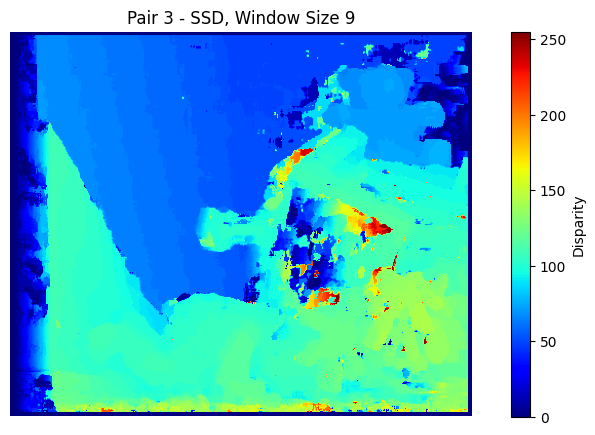

In [9]:
# Disparity computation for window sizes = 1, 5, 9 using both SAD & SSD
window_sizes = [1, 5, 9]
methods = ['SAD', 'SSD']

# Loop through each preprocessed stereo pair
for idx, (lI, rI) in enumerate(pairs):
    print(f"\nProcessing stereo pair {idx+1}...")
    for w in window_sizes:
        for method in methods:
            print(f"Computing disparity (w={w}, method={method})...")
            disp = compute_disparity_blockmatch(lI, rI, window_size=w, method=method, max_disp = 80)
            plot_disparity_map(disp, title=f"Pair {idx+1} - {method}, Window Size {w}")

Compute disparity by using Dynamic Programmming

In [ ]:
def compute_disparity_dp(lI, rI, sigma=2, c0=1):
    h, w = lI.shape
    left_disp_map = np.zeros_like(lI, dtype=np.float32)
    right_disp_map = np.zeros_like(rI, dtype=np.float32)

    for row in range(h):
        Il = lI[row].astype(np.float32)
        Ir = rI[row].astype(np.float32)
        N = len(Il)
        D = np.zeros((N, N), dtype=np.float32)
        # Cost matrix initialization
        for i in range(N):
            for j in range(N):
                dij = ((Il[i] - Ir[j]) ** 2) / (sigma ** 2)
                if i == 0 and j == 0:
                    D[i, j] = dij
                elif i == 0:
                    D[i, j] = D[i, j-1] + c0
                elif j == 0:
                    D[i, j] = D[i-1, j] + c0
                else:
                    D[i, j] = min(
                        D[i-1, j-1] + dij,
                        D[i-1, j] + c0,
                        D[i, j-1] + c0
                    )
        # Backtracking to compute disparity maps
        i, j = N - 1, N - 1
        while i > 0 and j > 0:
            cost = D[i, j]
            dij = ((Il[i] - Ir[j]) ** 2) / (sigma ** 2)
            if cost == D[i-1, j-1] + dij:
                disp = abs(i - j)
                left_disp_map[row, i] = disp
                right_disp_map[row, j] = disp
                i -= 1
                j -= 1
            elif cost == D[i-1, j] + c0:
                i -= 1
            else:
                j -= 1
    return left_disp_map, right_disp_map


def plot_disparity_map(disp_map, title="Disparity Map"):
    # Plot the disparity map using a color heatmap
    plt.figure(figsize=(10, 5))
    plt.title(title)
    plt.imshow(disp_map, cmap='jet')
    plt.colorbar(label='Disparity')
    plt.axis('off')
    plt.show()

Processing stereo pair 1


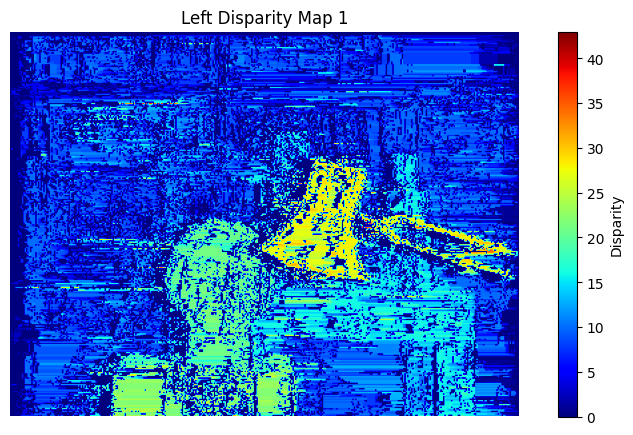

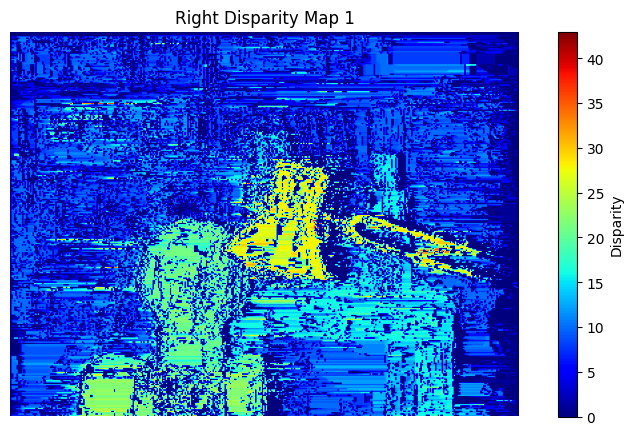

Processing stereo pair 2


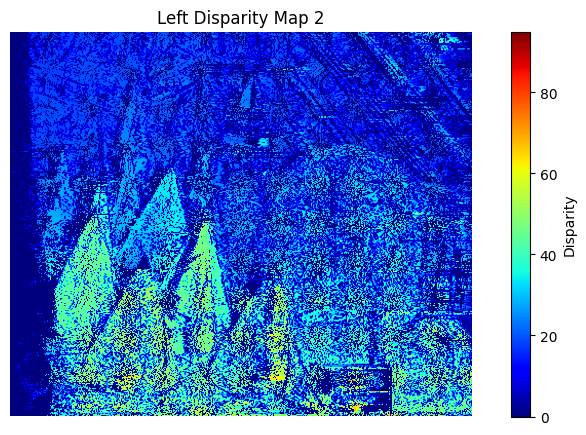

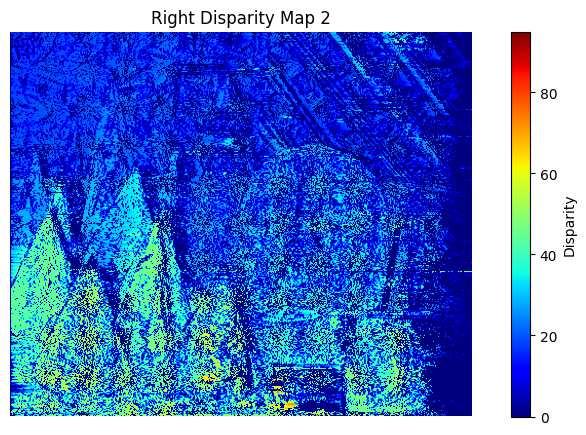

Processing stereo pair 3


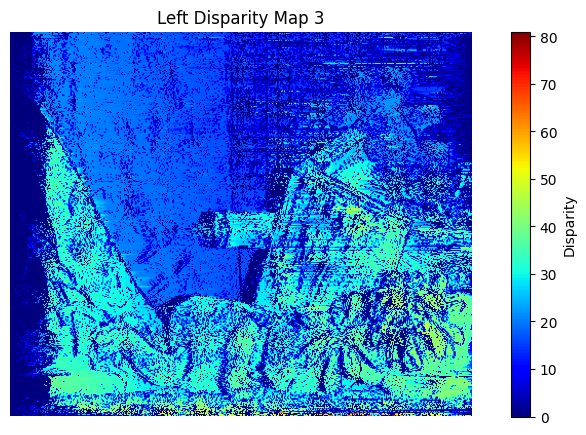

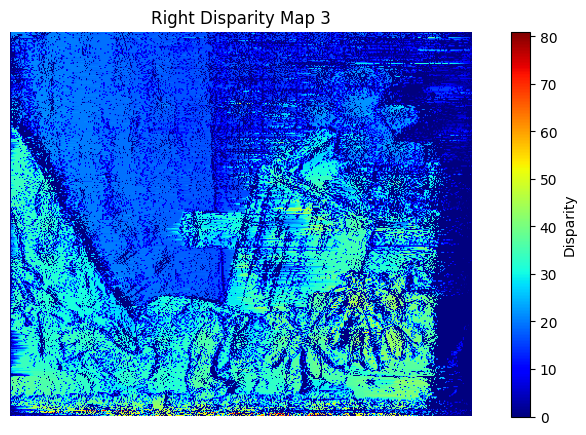

In [ ]:
# Run disparity computation and visualize
for idx, (lI, rI) in enumerate(pairs):
    print(f"Processing stereo pair {idx + 1}")
    left_disp, right_disp = compute_disparity_dp(lI, rI)
    plot_disparity_map(left_disp, title=f"Left Disparity Map {idx + 1}")
    plot_disparity_map(right_disp, title=f"Right Disparity Map {idx + 1}")
    print(f"Left disparity map (row 50) {idx + 1}:", left_disp[50])
    print(f"Right disparity map (row 50) {idx + 1}:", right_disp[50])

BONUS Part: Visual representation of the optimal alignment path bet. a scanline from the left and right images (for handling occlusions & matches along scanlines)

In [18]:
def compute_cost_matrix(left_row, right_row, sigma=2, c0=1):
    N = len(left_row)
    D = np.zeros((N + 1, N + 1))
    D[0, :] = np.arange(N + 1) * c0
    D[:, 0] = np.arange(N + 1) * c0
    
    for i in range(1, N + 1):
        for j in range(1, N + 1):
            dij = ((int(left_row[i - 1]) - int(right_row[j - 1])) ** 2) / (sigma ** 2)
            D[i, j] = min(
                D[i - 1, j - 1] + dij,
                D[i - 1, j] + c0,
                D[i, j - 1] + c0
            )
    return D


def plot_alignment(left_row, right_row, sigma=2, c0=1):
    D = compute_cost_matrix(left_row, right_row, sigma, c0)
    i, j = len(left_row), len(right_row)
    path_x, path_y = [j], [i]

    # Backtrack
    while i > 0 and j > 0:
        current = D[i, j]
        diag = D[i - 1, j - 1]
        up = D[i - 1, j]
        left = D[i, j - 1]
        dij = ((int(left_row[i - 1]) - int(right_row[j - 1])) ** 2) / (sigma ** 2)

        if current == diag + dij:
            i -= 1
            j -= 1
        elif current == up + c0:
            i -= 1
        else:
            j -= 1
        path_x.append(j)
        path_y.append(i)

    while i > 0:
        i -= 1
        path_x.append(j)
        path_y.append(i)
    while j > 0:
        j -= 1
        path_x.append(j)
        path_y.append(i)

    path_x = path_x[::-1]
    path_y = path_y[::-1]

    # Plot
    plt.figure(figsize=(10, 8))
    handles = {}
    for k in range(1, len(path_x)):
        x0, y0 = path_x[k - 1], path_y[k - 1]
        x1, y1 = path_x[k], path_y[k]
        if x0 == x1:
            label = 'Skip iL'
            color = 'red'
        elif y0 == y1:
            label = 'Skip iR'
            color = 'blue'
        else:
            label = 'Match'
            color = 'green'
        
        # Plot and store one handle per label
        line, = plt.plot([x0 + 1, x1 + 1], [y0 + 1, y1 + 1], color=color, linewidth=2)
        if label not in handles:
            handles[label] = line

    # Start and End
    plt.scatter(path_x[0] + 1, path_y[0] + 1, c='black', s=50)
    plt.text(path_x[0] + 1, path_y[0] + 1 - 5, "Start", ha='center', color='black', fontsize=12)
    plt.scatter(path_x[-1] + 1, path_y[-1] + 1, c='black', s=50)
    plt.text(path_x[-1] + 1, path_y[-1] + 1 + 5, "End", ha='center', color='black', fontsize=12)

    # Axis and labels
    plt.title("Alignment Path (iL vs iR)", fontsize=16)
    plt.xlabel("iR (Right Image)", fontsize=14)
    plt.ylabel("iL (Left Image)", fontsize=14)
    plt.xlim(0.5, len(right_row) + 0.5)
    plt.ylim(len(left_row) + 0.5, 0.5)
    plt.grid(True)

    # Show legend from unique handles
    plt.legend(handles.values(), handles.keys(), loc='center left', bbox_to_anchor=(1, 0.5), fontsize=12)
    plt.show()


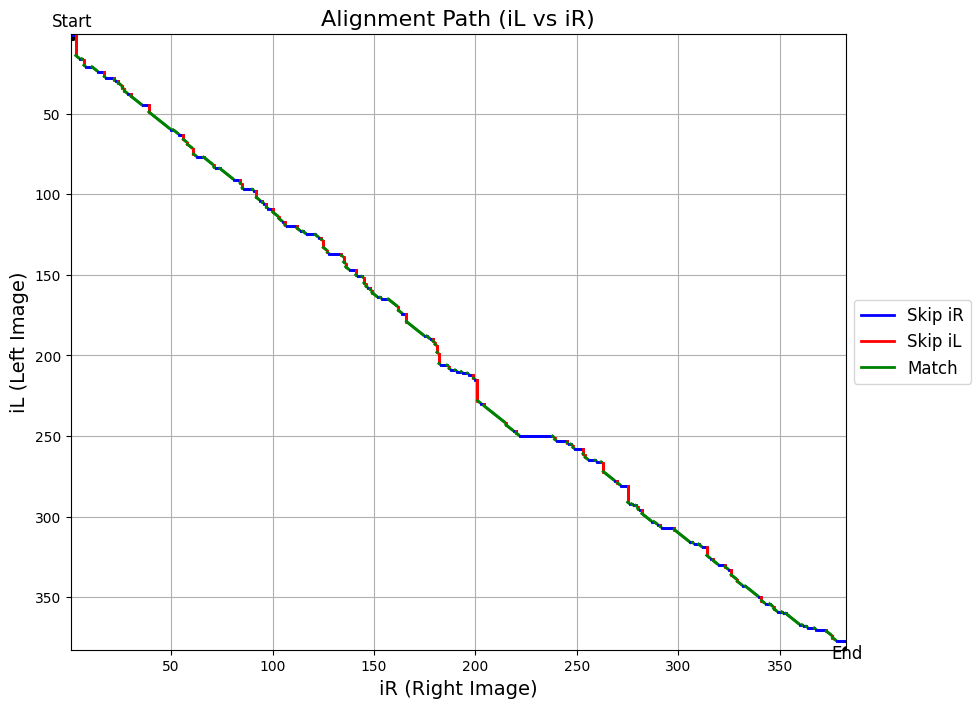

In [19]:
# Use first stereo pair for ex.
left_img, right_img = pairs[0]  
# Pick any row you like
row_idx = 100

plot_alignment(left_img[row_idx], right_img[row_idx])

Extra Part(1): Compute disparity by Block matching using NCC (alongside SAD & SSD methods)

In [ ]:
def compute_disparity_NCC(iL, iR, window_size, method, max_disp):
    h, w = iL.shape
    disparity = np.zeros((h, w), dtype=np.float32)
    half_w = window_size // 2

    for y in range(half_w, h - half_w):
        for x in range(half_w, w - half_w):
            best_offset = 0
            maximize = (method == 'NCC')
            best_score = -np.inf if maximize else np.inf
            left_patch = iL[y - half_w:y + half_w + 1, x - half_w:x + half_w + 1].astype(np.float64)

            for d in range(min(max_disp, x - half_w)):
                xr = x - d
                # Skip if right patch goes out of bounds
                if xr - half_w < 0:
                    continue

                right_patch = iR[y - half_w:y + half_w + 1, xr - half_w:xr + half_w + 1].astype(np.float64)

                if method == 'SAD':
                    cost = np.sum(np.abs(left_patch - right_patch))
                    is_better = cost < best_score
                elif method == 'SSD':
                    cost = np.sum((left_patch - right_patch) ** 2)
                    is_better = cost < best_score
                elif method == 'NCC':
                    numerator = np.sum(left_patch * right_patch)
                    denominator = np.sqrt(np.sum(left_patch ** 2) * np.sum(right_patch ** 2))
                    # Skip unstable comparisons
                    if denominator < 1e-5:
                        continue
                    cost = numerator / denominator
                    is_better = cost > best_score
                else:
                    raise ValueError("Unsupported method: use 'SAD', 'SSD', or 'NCC'.")

                if is_better:
                    best_score = cost
                    best_offset = d
            disparity[y, x] = best_offset
    # Normalize only for visualization
    disparity = cv2.normalize(disparity, None, 0, 255, cv2.NORM_MINMAX)
    return disparity.astype(np.uint8)


def plot_disparity_map(disp_map, title="Disparity Map"):
    plt.figure(figsize=(10, 5))
    plt.title(title)
    plt.imshow(disp_map, cmap='jet')
    plt.colorbar(label='Disparity')
    plt.axis('off')
    plt.show()


Processing stereo pair 1...
Computing disparity (w=1, method=NCC)...


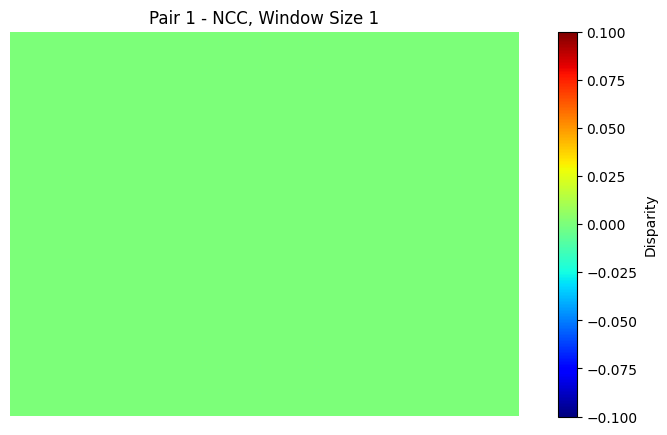

Computing disparity (w=5, method=NCC)...


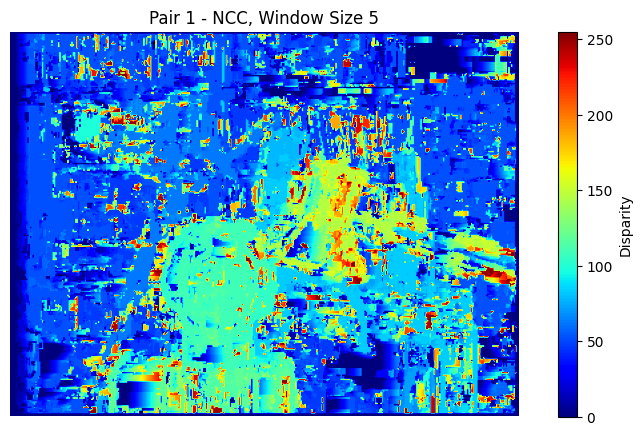

Computing disparity (w=9, method=NCC)...


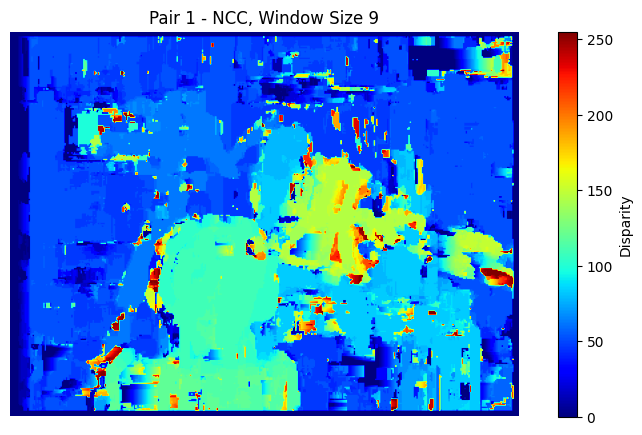


Processing stereo pair 2...
Computing disparity (w=1, method=NCC)...


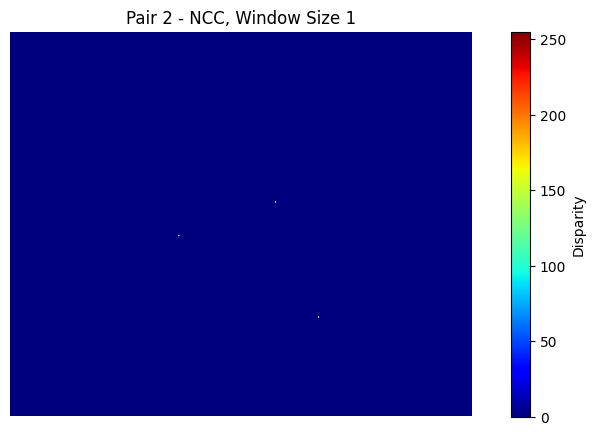

Computing disparity (w=5, method=NCC)...


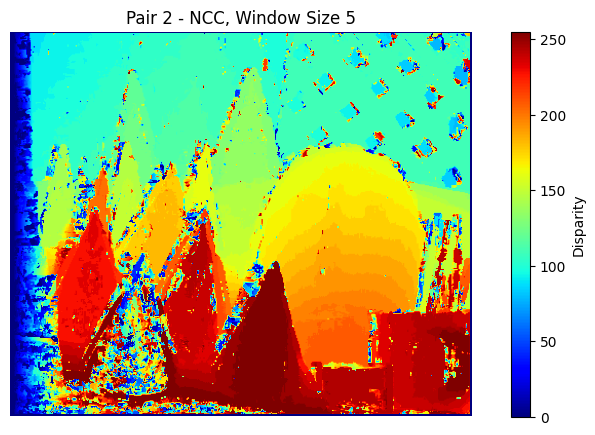

Computing disparity (w=9, method=NCC)...


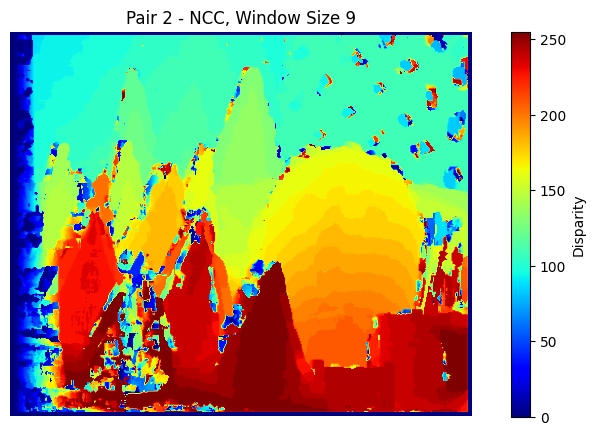


Processing stereo pair 3...
Computing disparity (w=1, method=NCC)...


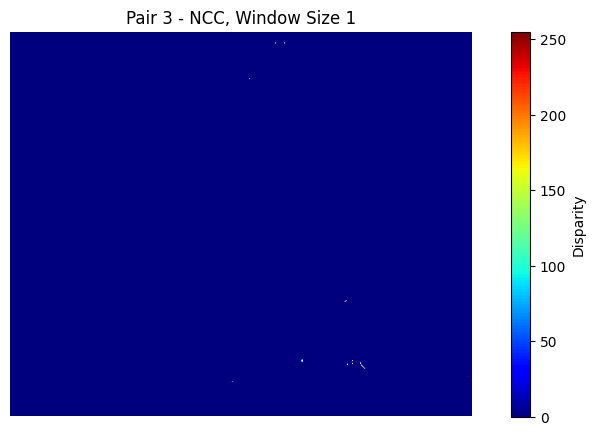

Computing disparity (w=5, method=NCC)...


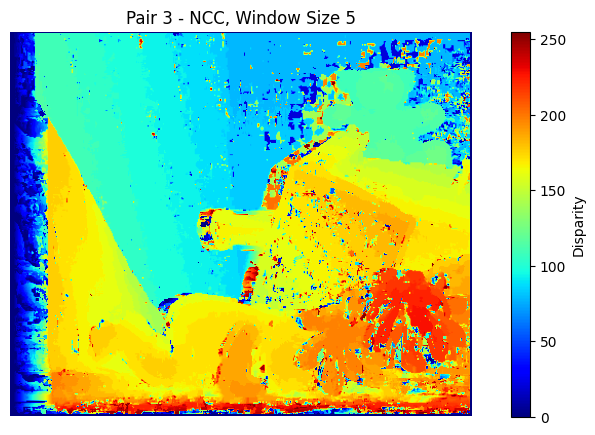

Computing disparity (w=9, method=NCC)...


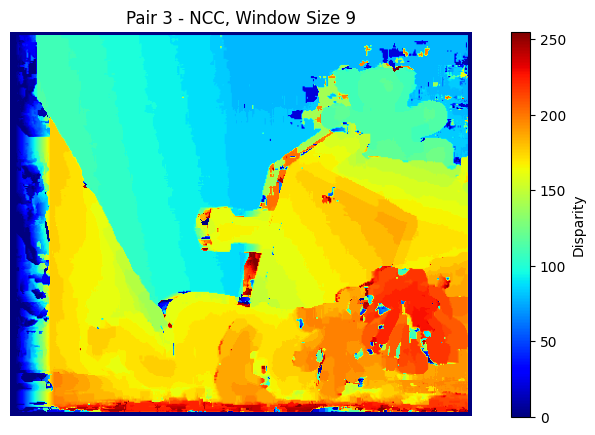

In [ ]:
# Disparity computation for window sizes = 1, 5, 9 using NCC
window_sizes = [1, 5, 9]
methods = ['NCC']

for idx, (iL, iR) in enumerate(pairs):
    print(f"\nProcessing stereo pair {idx+1}...")
    for w in window_sizes:
        for method in methods:
            print(f"Computing disparity (w={w}, method={method})...")
            disp = compute_disparity_NCC(iL, iR, window_size=w, method=method, max_disp = 50)
            plot_disparity_map(disp, title=f"Pair {idx+1} - {method}, Window Size {w}")

Plotting for Stereo Pair 1, Window Size 5, Method SAD


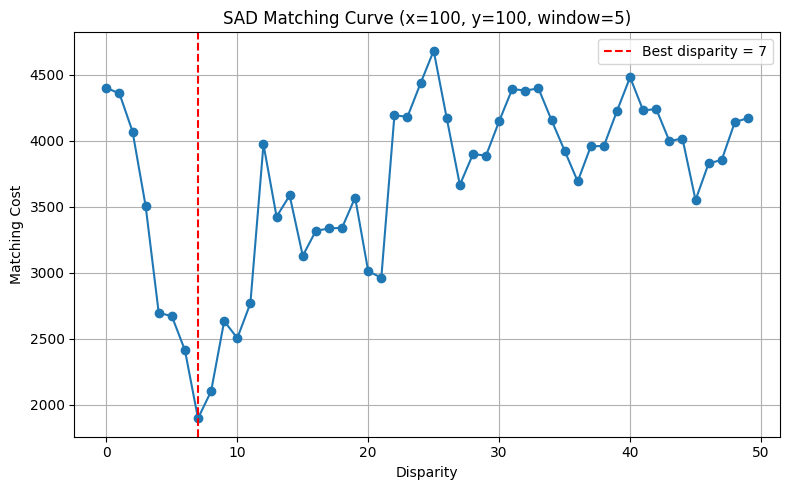

Plotting for Stereo Pair 1, Window Size 5, Method SSD


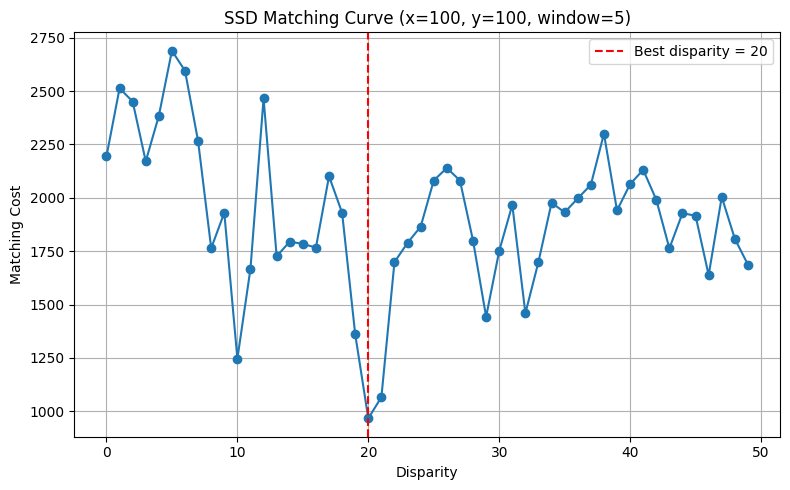

Plotting for Stereo Pair 1, Window Size 5, Method NCC


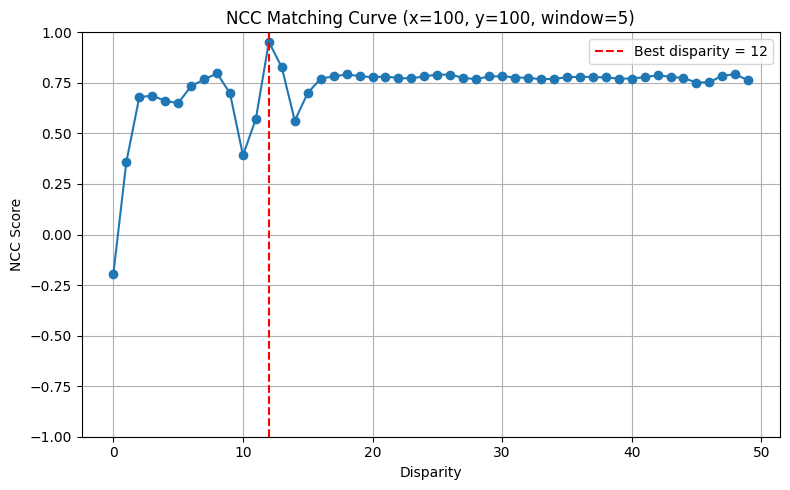

Plotting for Stereo Pair 1, Window Size 7, Method SAD


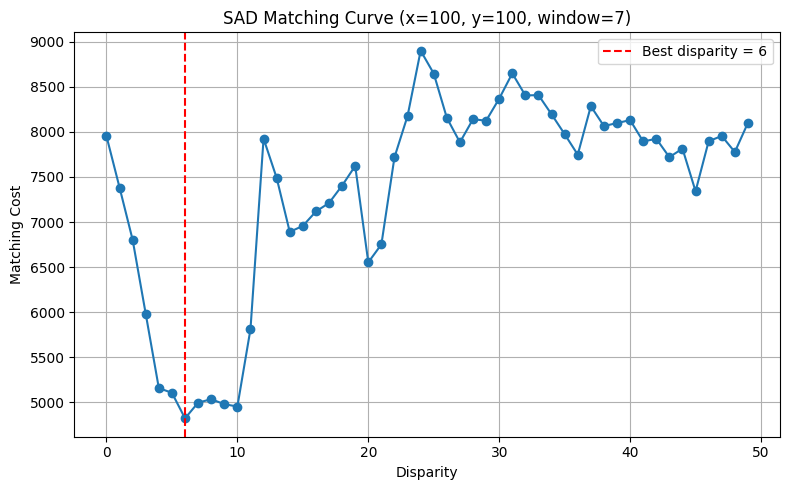

Plotting for Stereo Pair 1, Window Size 7, Method SSD


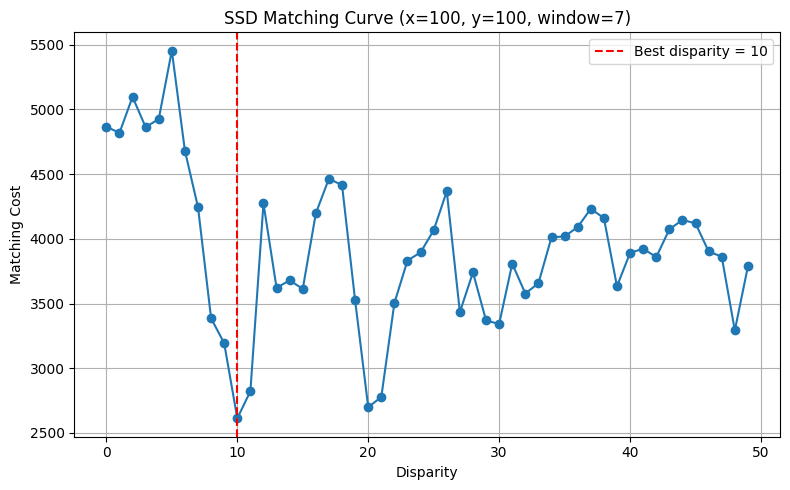

Plotting for Stereo Pair 1, Window Size 7, Method NCC


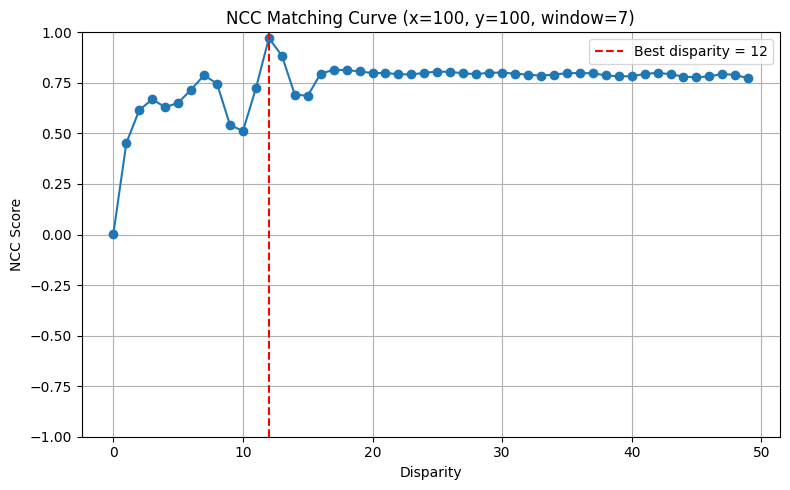

Plotting for Stereo Pair 1, Window Size 9, Method SAD


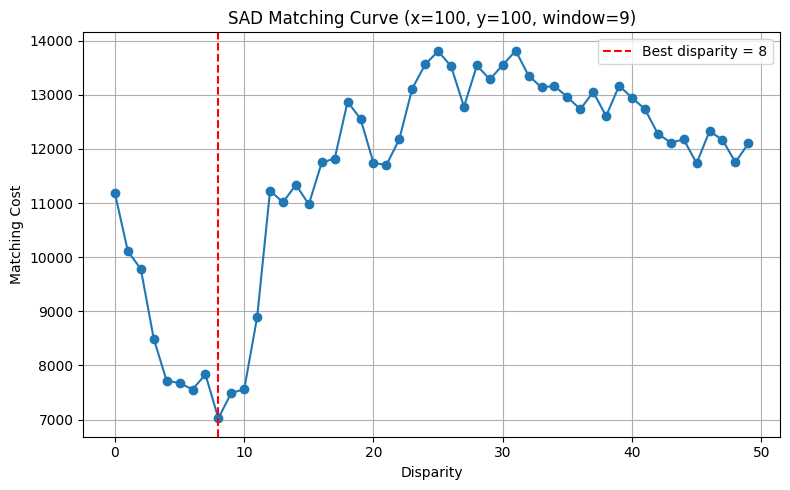

Plotting for Stereo Pair 1, Window Size 9, Method SSD


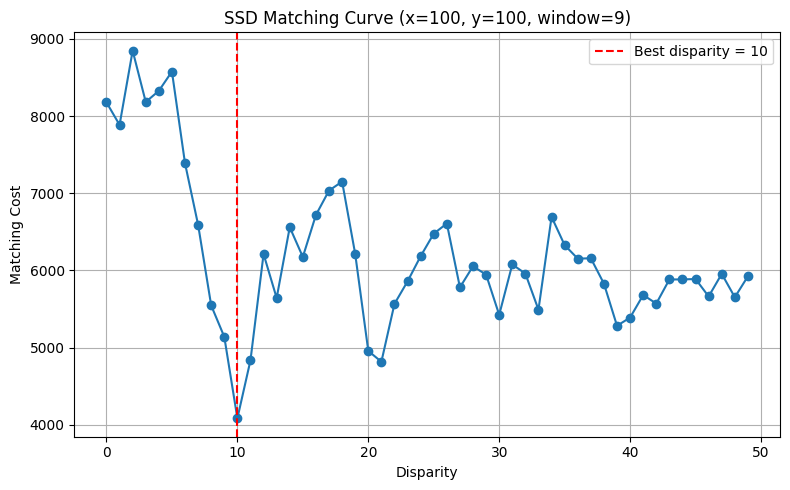

Plotting for Stereo Pair 1, Window Size 9, Method NCC


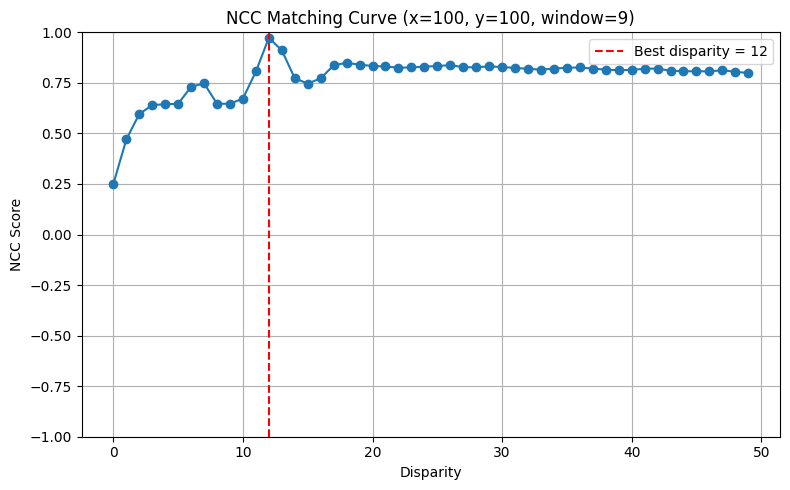

Plotting for Stereo Pair 2, Window Size 5, Method SAD


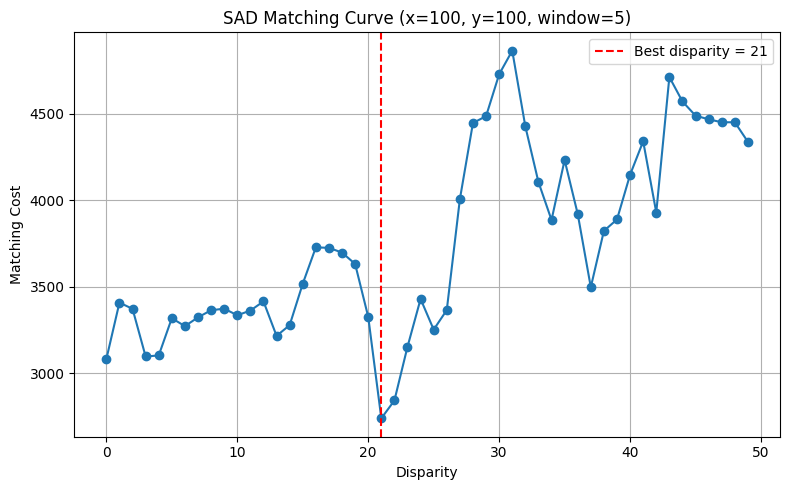

Plotting for Stereo Pair 2, Window Size 5, Method SSD


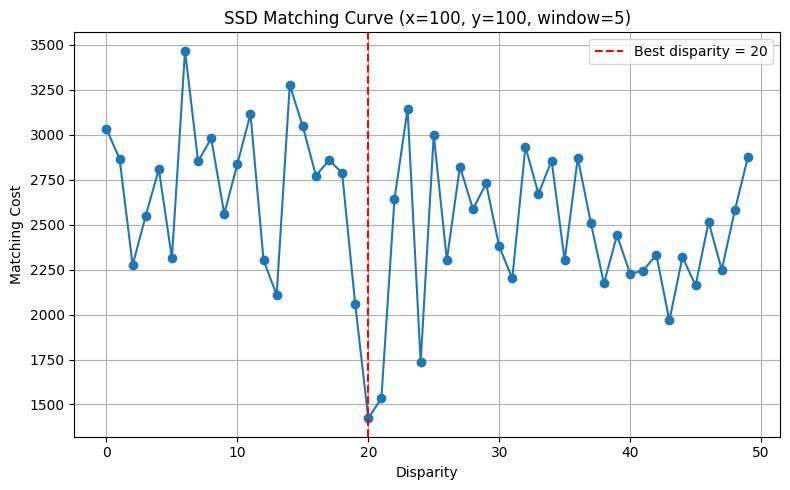

Plotting for Stereo Pair 2, Window Size 5, Method NCC


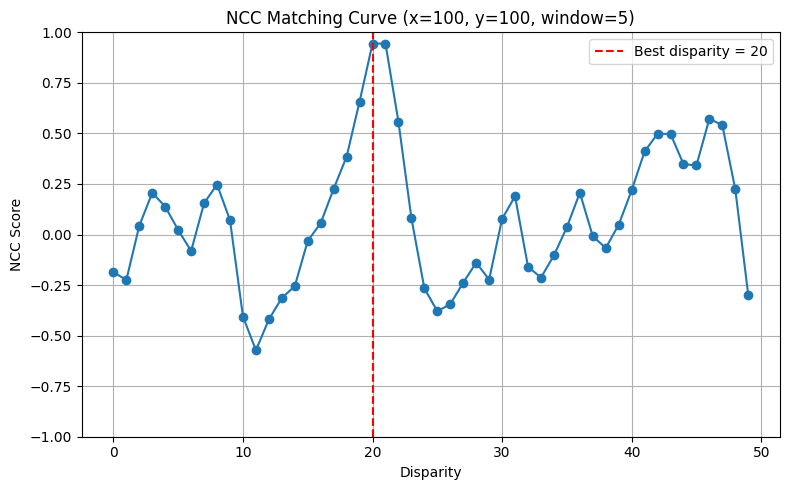

Plotting for Stereo Pair 2, Window Size 7, Method SAD


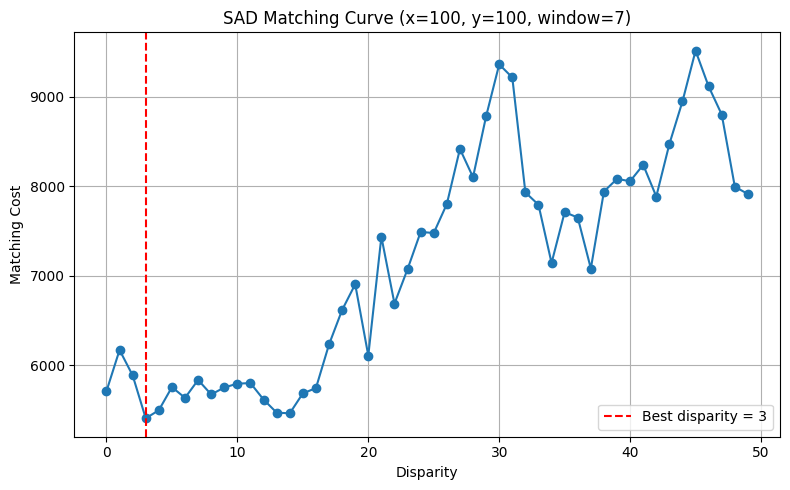

Plotting for Stereo Pair 2, Window Size 7, Method SSD


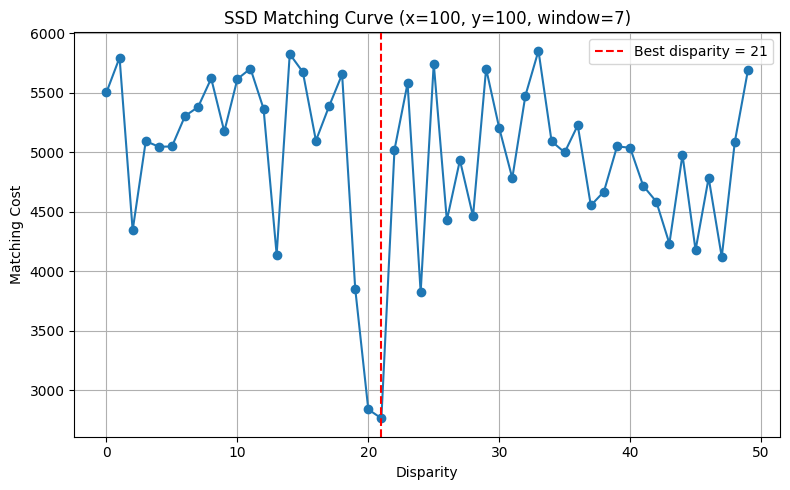

Plotting for Stereo Pair 2, Window Size 7, Method NCC


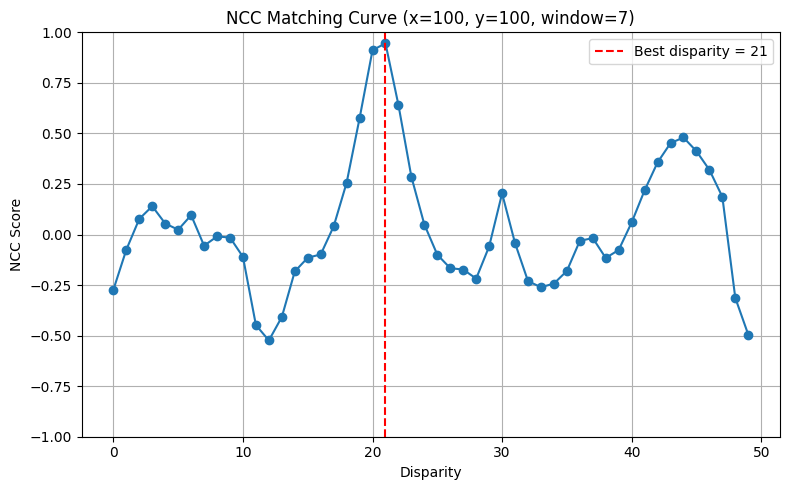

Plotting for Stereo Pair 2, Window Size 9, Method SAD


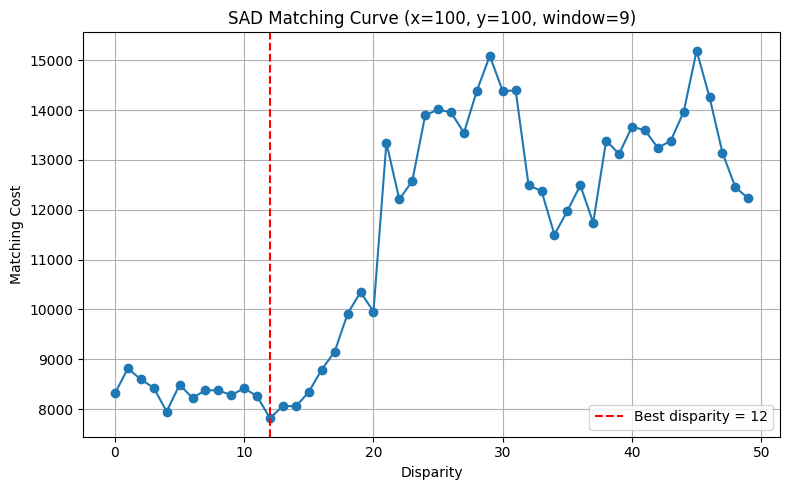

Plotting for Stereo Pair 2, Window Size 9, Method SSD


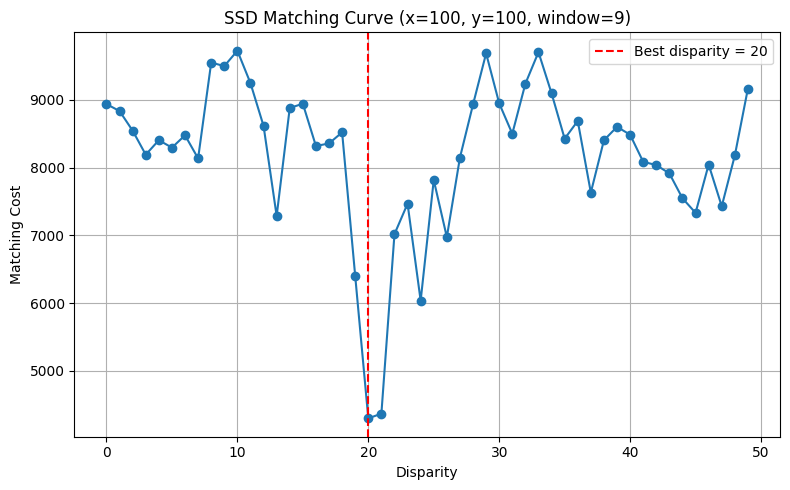

Plotting for Stereo Pair 2, Window Size 9, Method NCC


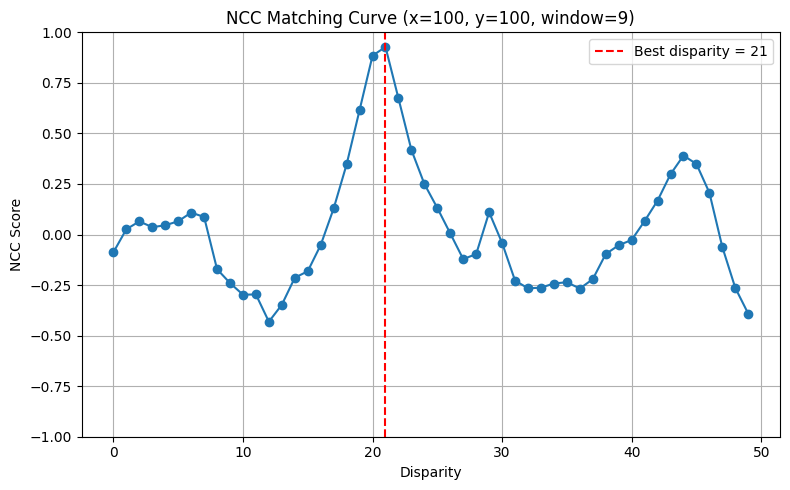

Plotting for Stereo Pair 3, Window Size 5, Method SAD


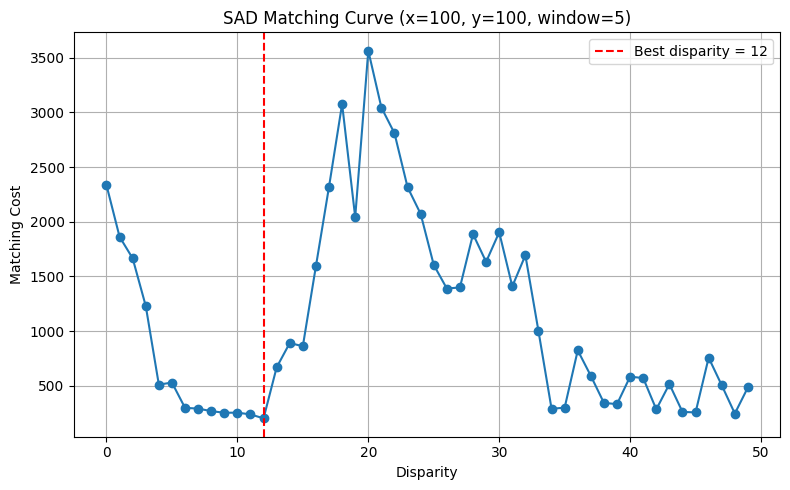

Plotting for Stereo Pair 3, Window Size 5, Method SSD


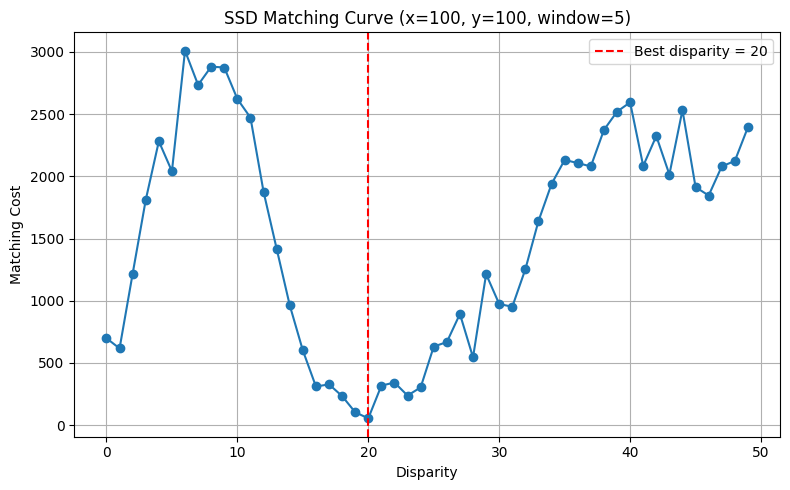

Plotting for Stereo Pair 3, Window Size 5, Method NCC


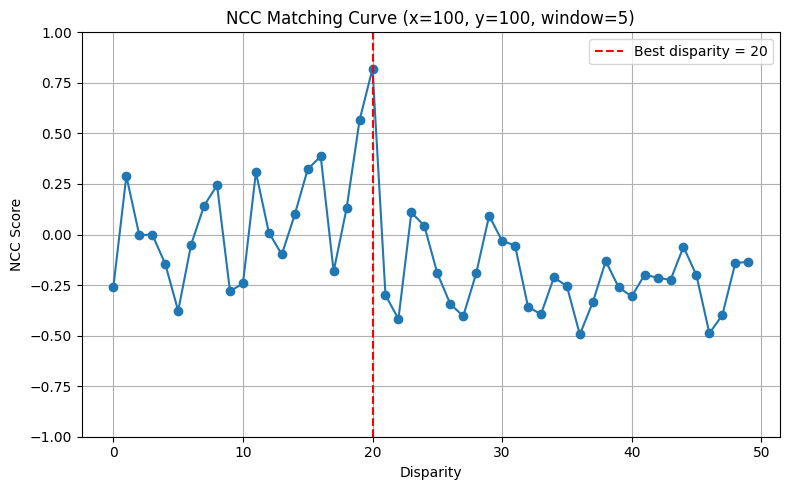

Plotting for Stereo Pair 3, Window Size 7, Method SAD


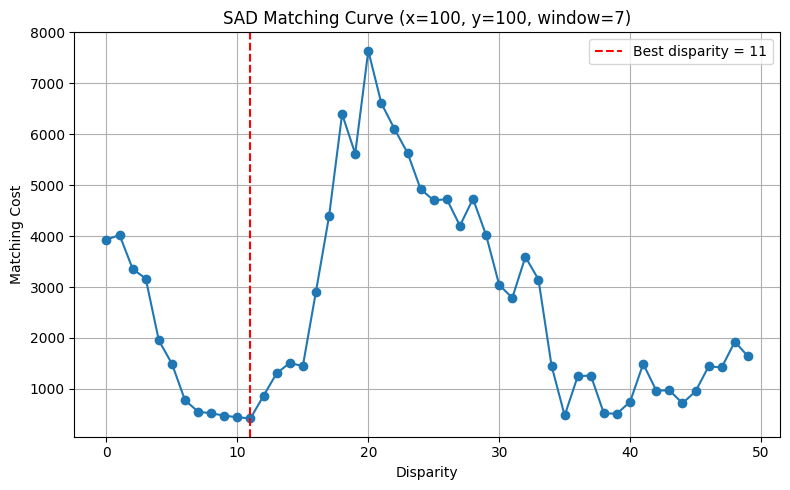

Plotting for Stereo Pair 3, Window Size 7, Method SSD


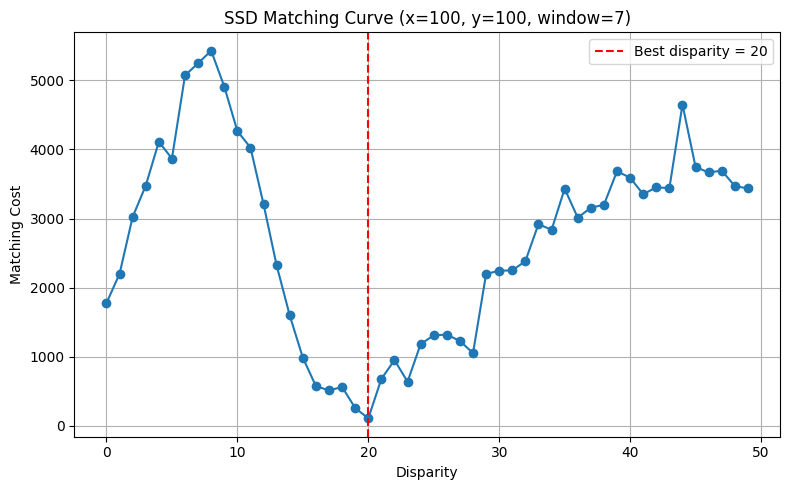

Plotting for Stereo Pair 3, Window Size 7, Method NCC


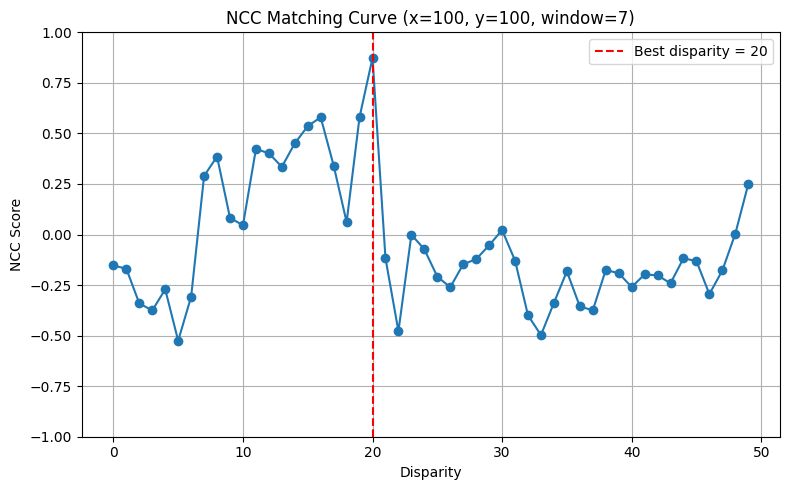

Plotting for Stereo Pair 3, Window Size 9, Method SAD


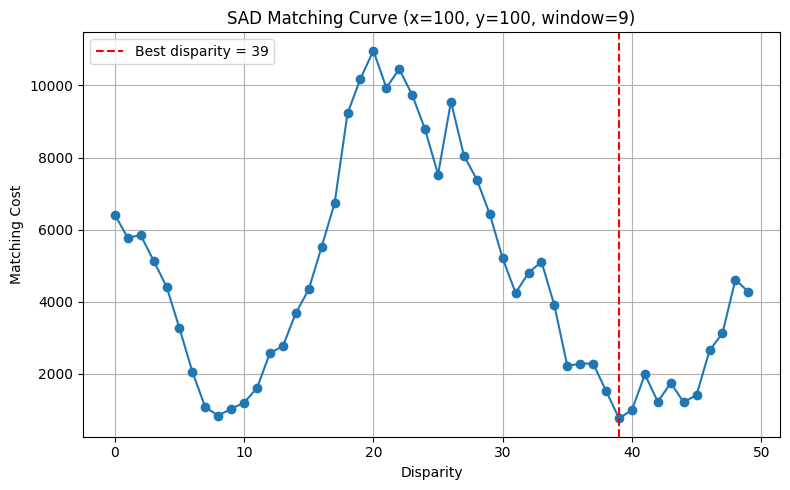

Plotting for Stereo Pair 3, Window Size 9, Method SSD


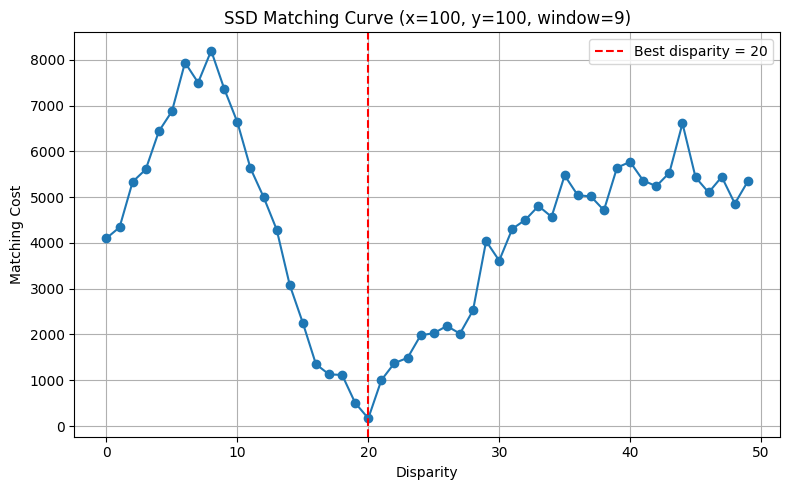

Plotting for Stereo Pair 3, Window Size 9, Method NCC


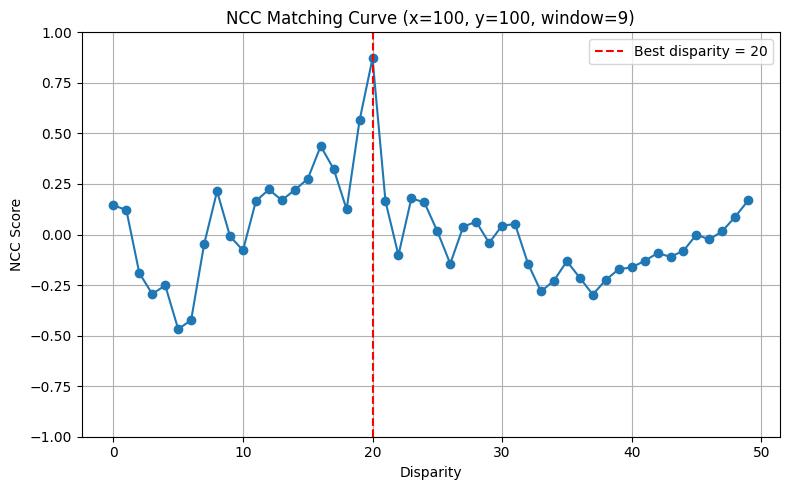

In [ ]:
def plot_matching_cost_curve(iL, iR, window_size, method, max_disp=50, x=100, y=100):
    half_w = window_size // 2
    disparity_range = list(range(max_disp))
    def compute_cost(left_patch, right_patch, method):
        if method == 'SAD':
            return np.sum(np.abs(left_patch - right_patch))
        elif method == 'SSD':
            return np.sum((left_patch - right_patch) ** 2)
        elif method == 'NCC':
            left_mean = np.mean(left_patch)
            right_mean = np.mean(right_patch)
            left_norm = left_patch - left_mean
            right_norm = right_patch - right_mean
            numerator = np.sum(left_norm * right_norm)
            denominator = np.sqrt(np.sum(left_norm ** 2) * np.sum(right_norm ** 2))
            if denominator == 0:
                return 0.0  # No correlation
            return numerator / denominator  # Higher is better
        else:
            raise ValueError("Unsupported method: use 'SAD', 'SSD', or 'NCC'.")

    # Extract patch from left image
    left_patch = iL[y - half_w:y + half_w + 1, x - half_w:x + half_w + 1]
    costs = []
    valid_disparities = []
    for d in disparity_range:
        xr = x - d
        if xr - half_w < 0:
            continue
        right_patch = iR[y - half_w:y + half_w + 1, xr - half_w:xr + half_w + 1]
        cost = compute_cost(left_patch, right_patch, method)
        costs.append(cost)
        valid_disparities.append(d)

    # Determine best disparity
    if method in ['SAD', 'SSD']:
        best_disp = valid_disparities[np.argmin(costs)]
        ylabel = "Matching Cost"
    elif method == 'NCC':
        best_disp = valid_disparities[np.argmax(costs)]
        ylabel = "NCC Score"

    # Plot
    plt.figure(figsize=(8, 5))
    plt.title(f"{method} Matching Curve (x={x}, y={y}, window={window_size})")
    plt.xlabel("Disparity")
    plt.ylabel(ylabel)
    plt.plot(valid_disparities, costs, marker='o', linestyle='-')
    plt.axvline(best_disp, color='red', linestyle='--', label=f"Best disparity = {best_disp}")
    if method == 'NCC':
        plt.ylim([-1.0, 1.0])
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


# List of window sizes
window_sizes = [5, 7, 9]
# Loop through each stereo pair, window sizes, and methods
for idx, (iL, iR) in enumerate(pairs):
    for window_size in window_sizes:
        for method in ['SAD', 'SSD', 'NCC']:
            print(f"Plotting for Stereo Pair {idx+1}, Window Size {window_size}, Method {method}")
            plot_matching_cost_curve(iL, iR, window_size, method)